In [1]:
%reload_ext autoreload
%autoreload 2

In [1]:
import os
import math
import sys
import time
import datetime
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import imageio
from pathlib import Path
#import cv2
from fastai.vision import *
from fastai.metrics import error_rate

#from utils.trainer_functions import *

In [5]:
# See your current version of python/anaconda
print (sys.version)

3.7.6 | packaged by conda-forge | (default, Jan  7 2020, 21:48:41) [MSC v.1916 64 bit (AMD64)]


# Use this function to create your normalized images

In [17]:
# Normalize the masks...
def normalize_images(root_path, mask_folder, save_folder):
    #root_path = Path(r"C:\Users\William\Desktop\data - Copy\cleaned")
    root_path = Path(r"C:\Users\payman\Documents\Insight_Project\scrapworks\Test_Models\Model1\Data")
    mask_path = root_path/'trainY_pngs'#Path(r"C:\Users\Rocheleau Microscope\.fastai\data\Mask Trainer\Mask\INS1E\20190307W")
    save_path = root_path/'trainY_pngs_norm_dummy'

    save_path.mkdir(parents = True ,exist_ok = True)
    
    colours = [([255,255,255], 0),
               ([255,0,0], 1),
               ([0,0,255], 2),
               ([255,242,0], 3),
               ([0,255,0],4),
          ]


    for files in mask_path.iterdir():
        reader = imageio.get_reader(str(files))
        img = reader.get_data(0)
        norm_img = np.zeros(img.shape[:2], dtype = np.uint8)
        print(norm_img.shape)
        
        
        for (colour, value) in colours:
            r,g,b = colour
            colours_match = np.all([img[:,:,0] == r, img[:,:,1] == g, img[:,:,2] == b], axis=0)
            norm_img[colours_match] = value




        imageio.imwrite(str(save_path/files.name), norm_img)
        #print(np.amax(img))




In [7]:
"""Only run the below code if you need to normalize your masks"""
normalize_images(root_path = r"C:\Users\payman\Documents\Insight_Project\scrapworks\Test_Models\Model1\Data", 
                 mask_folder = 'trainY_pngs', 
                 save_folder = 'trainY_pngs_norm_dumy')

(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(110

(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)
(1100, 850)


# This cell has many important parameters

- The most important is to change the root path to your data folder
- bs is the batch size and should be lowered if you run out of RAM
- size is the size that you will resize the images to.  Ideally a mulltiple of 7 (400 is a bad number)
- changing the resize_method in the data = block will change how the images are resized.  Your options are ResizeMethod.SQUISH and ResizeMethod.PAD

In [18]:
"""Step 1: Determine where the training images are stored"""
root_path = Path(r"C:\Users\payman\Documents\Insight_Project\scrapworks\Test_Models\Model1\Data")
seg_path = root_path/"trainX_pngs"
codes_path = root_path/"codes_dumy.txt"

In [19]:
"""Step 2: Determine how to get the mask name from the image name"""
def get_y_lambda_function(root_path, mask_folder = 'trainY_pngs_norm_dumy', image_folder = 'trainX_pngs'):
    return lambda filename: root_path/mask_folder/filename.relative_to(root_path/image_folder).parent/(filename.name.replace('input', 'target'))

get_mask_func = get_y_lambda_function(root_path)

In [20]:
"""Step 3: Change any of the default parameters:"""
lr = 2e-4                   #Learning Rate
bs = 4                      #Batch Size
size = 350 # 400                  #Size of the network (images reshaped to (sz, sz))
model = models.resnet34     #Model 
export_name = 'RandABHome.pkl'  #Export Name
wd = 1e-3
penalty = 1
tfms = get_transforms()
tfms = [[],[]]

In [21]:
"""Step 4: Detemine how you want you accuracy to be determined"""
def acc_segmentation(input_image, target):
    target = target.squeeze(1)
    return (input_image.argmax(dim=1)==target).float().mean()

In [22]:
"""Step 5: Load the pixel value to feature codes"""

codes = np.loadtxt(codes_path, dtype = 'str')
name2id = {code:number for number,code in enumerate(codes)}

In [23]:
"""Step 6: Create your dataset"""
#Note: Use ResizeMethod.PAD to pad to a square and SQUISH to squish the larger axis
data = (SegmentationItemList
         .from_folder(seg_path, recurse = True)
         .split_by_rand_pct()
         .label_from_func (get_mask_func, classes = codes)
         .transform(tfms = tfms, size = size, tfm_y = True, padding_mode = 'border', resize_method = ResizeMethod.SQUISH)
         .databunch(bs = bs, num_workers = 0))

In [24]:
"""Step 7: Train your learner """

learn = unet_learner(data, model, wd = wd, metrics = [acc_segmentation])
                 #loss_func = CrossEntropyFlat(axis=1, weight = torch.FloatTensor([1,penalty]).cuda())
                  #  )

# Train the model with most of the layers frozen

epoch,train_loss,valid_loss,acc_segmentation,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


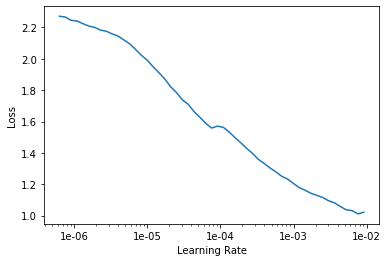

In [24]:
"""Find the appropriate learning rate by choosing an area of continuous descent"""

learn.lr_find()
learn.recorder.plot()
#The results indicate that 


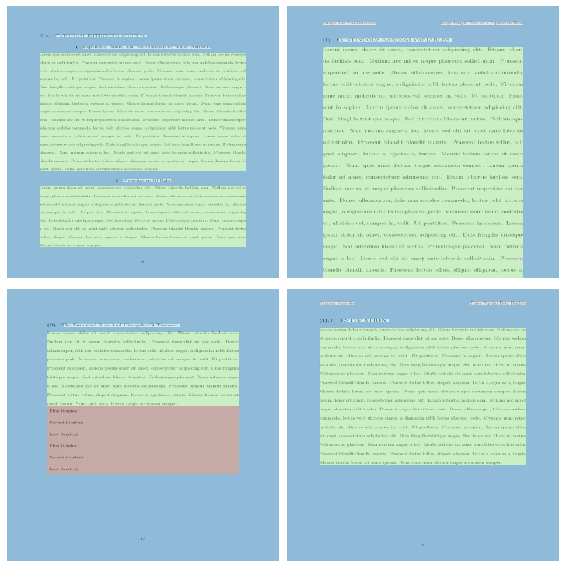

In [27]:
data.show_batch()

In [28]:
learn.fit_one_cycle(5, max_lr = lr)

epoch,train_loss,valid_loss,acc_segmentation,time
0,0.336653,0.224761,0.928509,1:08:56
1,0.200082,0.180214,0.949906,1:29:34


KeyboardInterrupt: 

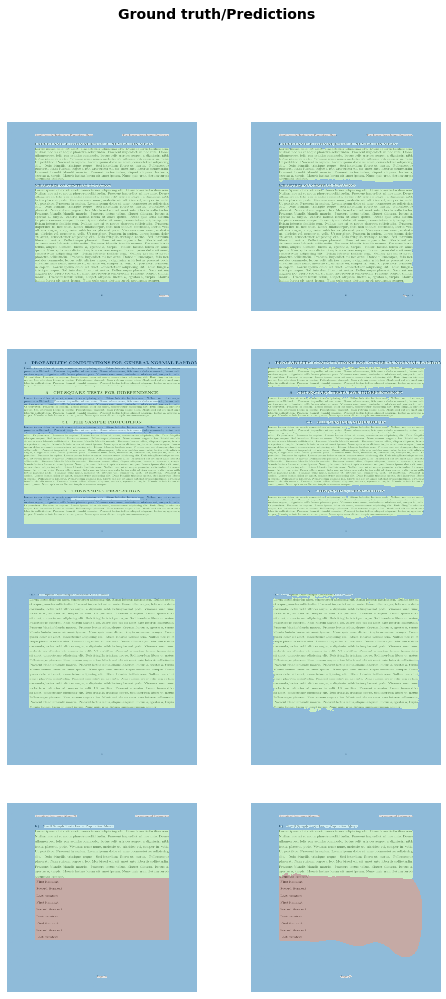

In [25]:
learn.show_results()

# Next we unfreeze the rest of the layers and retrain using a new learning rate

In [37]:
"""When we unfreeze the layers, they can all be trained"""
learn.unfreeze()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


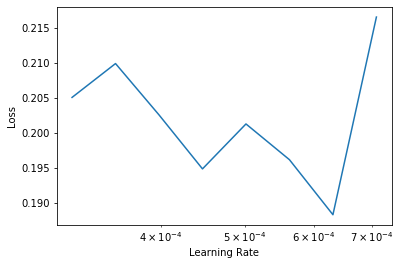

In [39]:
"""We must choose a new learning rate to optimize training"""

learn.lr_find(start_lr = 1e-4)
learn.recorder.plot()
#results suggest 

In [40]:
learn.fit_one_cycle(20, max_lr = lr/10)

epoch,train_loss,valid_loss,acc_segmentation,time
0,0.092474,0.103080,0.969556,02:28
1,0.088832,0.103403,0.969839,02:27
2,0.082971,0.102917,0.969366,02:27
3,0.080990,0.098598,0.971079,02:25
4,0.079246,0.099092,0.971443,02:27
5,0.073457,0.102766,0.971175,02:26
6,0.069407,0.103491,0.971246,02:29
7,0.061995,0.105087,0.972332,02:29
8,0.057863,0.116038,0.970548,02:29
9,0.051692,0.106221,0.973038,02:34


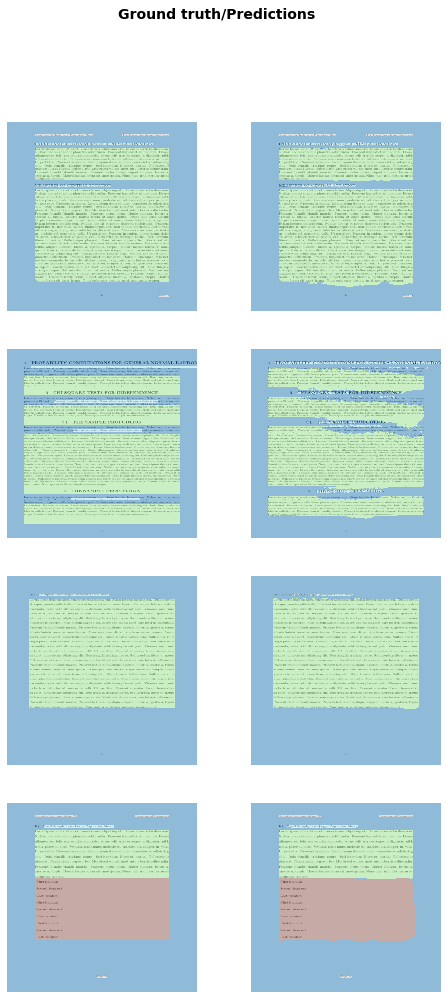

In [41]:
learn.show_results()

In [42]:
learn.export(r"C:\Users\payman\Documents\Insight_Project\scrapworks\Test_Models\Model1\Test_Model_dumy.pkl")

# Import the model

In [25]:
imported_learn = load_learner(r"C:\Users\payman\Documents\Insight_Project\scrapworks\Test_Models\Model1", "Test_Model.pkl", num_workers = 0)

C:\Users\payman\Anaconda3\envs\fastai\lib\site-packages\torch\serialization.py:593: SourceChangeWarning: source code of class 'torch.nn.modules.loss.CrossEntropyLoss' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
C:\Users\payman\Anaconda3\envs\fastai\lib\site-packages\torch\serialization.py:593: SourceChangeWarning: source code of class 'fastai.vision.models.unet.DynamicUnet' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
C:\Users\payman\Anaconda3\envs\fastai\lib\site-packages\torch\serialization.py:593: SourceChangeWarning: source code of class 'torch.nn.modules.container.ModuleList' has changed. you can retrieve the origi

In [26]:
img = open_image(r"C:\Users\payman\Documents\Insight_Project\scrapworks\Test_Models\Model1\Data\trainX_pngs\pdf_input_000_5-000001.png")

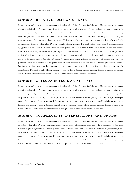

In [27]:
img.show()

In [28]:
imported_learn.predict(img)[0].show()

AttributeError: 'PixelShuffle_ICNR' object has no attribute 'do_blur'

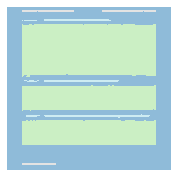

In [45]:
imported_learn.predict(img)[0].show()

# Everything below here is for reference...


<a id='unet_trainer'></a>
# Unet Network Training Experimentation

The goal of this program is to easily be able to compare the results of different combinations of labels in order to get a mask segmentation of the cells for later use.  It begins with the output of either the YOLO or the SSD network (simulated by manual ROI selection) and then uses the outputs from the SubimageGeneration section combined with manually created ground truths.  A future iteration will involve the ability to combine individual segmentations back into the main image, and then introduce a "Main Cell" vs "Auxillary Cell" class difference and the change the loss function to accomodate it (giving a much higher loss to the classifications of pixels as "Main Cell" when they are actually "Auxillary Cells").  If it works really well but doesn't distinguish well between the main cells and auxillary cells, I can always delete the segmentation for the auxillary cells manually and build my training dataset that way. 



In the open function, there will be a default behaviour for channels under 20 and the custom behaviour for other channels.  That will allow me to introduce interesting features like merging and randomness


The combinations that I'm planning on testing are as follows:
- Three Brightfield Channels (-10, 0, 10), (-7, 0, 7), (-3, 0, 3)
- Two Brightfield Channels and One Fluorescence
- One Brightfield and Two Fluorescence
- Two Brightfield and a merge of all of the fluorescence channels (add a special method to the open files function if the channel is above 16 (ex. 100 means merge all channels) - this will reduce the impact of a specific channel not being labelled


There will also be a randomness componenent added, which I will introduce by overwriting the channels above 100.  The channels will include:
- Two brightfield and one random fluorescence
- One "Below Focus" Image, One in focus, and One "Above Focus"
- Three Randomly Chosen Brightfield Images (sort them afterwards.  Duplicates allowed??? - Harder to implement with the current approach)



Other factors I can train are size

### Links to the relevant cells:
- [Core Helper Functions](#core_helper): Always run these cells before beginning!
- [General Training Functions](#general_training): This section will be your general trainer for a single model
- [Training Tester](#training_tester): This section will allow you to test many different combinations at once
- [Model Tester](#model_tester): Explore Aspects of your trained model (Work in progress...)
- [Transformation Tester](#transformation_tester): This section will allow you to look at the results of various transformations




## Core Helper Functions

<a id='core_helper'></a>

In [4]:
#root_path = Path(r'C:\Users\Rocheleau Analysis\.fastai\data\SegmentationTester')

"""Note:
This code is also found in fastai_helper.py

"""
CURRENT_CHANNELS = [0,3,6]        
SPECIAL_DROPOUT_RATE = 0.0
DROPOUT_RATE = 0.0

#Support Functions
def get_y_lambda_function(root_path, mask_folder = 'Mask_Norm', image_folder = 'FullImage'):
    return lambda filename: root_path/mask_folder/filename.relative_to(root_path/image_folder).parent/(filename.name.replace('ome.tif', 'png'))

def load_core_paths(root_path):
    mask_path = root_path/"Mask" ; mask_path.mkdir(exist_ok = True)
    seg_path = root_path/"FullImage" ; seg_path.mkdir(exist_ok = True)
    codes_path = root_path/"codes.txt"
    model_path = root_path/'Models' ; model_path.mkdir(exist_ok = True)
    figures_path = root_path/'Figures' ; figures_path.mkdir(exist_ok = True)

    codes = np.loadtxt(codes_path, dtype = 'str')
    return (mask_path, seg_path, codes_path, model_path, figures_path, codes)

def acc_segmentation(input_image, target):
    target = target.squeeze(1)
    return (input_image.argmax(dim=1)==target).float().mean()

def open_channel(channel, reader, div):
    
    if reader.get_length() == 1:
        import_img = np.asarray(reader.get_data(0))
        x1, x2, x3 = import_img.shape
        #print("Exception...", import_img.shape)
        if x1<5: import_img = import_img[channel, :,:]
        else: import_img = import_img[:,:, channel]
    
    else:
        import_img = np.asarray(reader.get_data(channel))
        
    if div: import_img = np.divide(import_img, np.amax(import_img))
    return (import_img)
     
def merge_channels(channels, reader, div, dropout_rate = 0.0):
    num_channels = len(channels)
    merged_image = np.zeros(reader.get_data(0).shape)
    for ch in channels:
        if np.random.uniform() > dropout_rate:
            temp_channel = open_channel(ch, reader, div)
            merged_image += temp_channel/np.amax(temp_channel)/num_channels
            #print ("Kept channel", ch)
        #else: print ("Dropped channel", ch)
    return (merged_image)


def get_channel(channel, reader, div, dropout_chance = DROPOUT_RATE):
    if channel<20:
        return (open_channel(channel, reader, div))
    
    elif channel == 100: #Merge first of all Fluorescence Channels
        return (merge_channels([0,3,6], reader, div))
        
    elif channel == 101: #Random Lower BR Channel
        channel =  (np.random.randint(9, 12))
        return (open_channel(channel, reader, div))
    
    
    elif channel == 102: #Random Upper BR Channel
        channel =  (np.random.randint(13, 16))
        return (open_channel(channel, reader, div))
    
    elif channel == 103: #Random BR Channel
        channel =  (np.random.randint(9, 16))
        return (open_channel(channel, reader, div))
    
    elif channel == 104: #Merge all BR Channels
        return (merge_channels(range(9, 16), reader, div))
    
    
    elif channel == 107:  #Any random channels
        channel =  (np.random.randint(0, 16))
        return (open_channel(channel, reader, div))
    
    elif channel == 108:  #One of the fluorescent channels
        fluorescent_channels  = [0,3,6]
        channel = np.random.choice(fluorescent_channels, 1)
        return (open_channel(channel, reader, div))
    
    elif channel == 110: #Black Channel
        return(np.zeros(reader.get_data(0).shape))
    
    elif channel == 111: #Dropout Merge of Fluorescent Channels
        return (merge_channels([0,3,6], reader, div, SPECIAL_DROPOUT_RATE))
    
    
    elif channel >= 200:     #Lots of room for errors with this...  Will default to the 200 code if it pases the dropout test
        if np.random.uniform()>dropout_chance: 
            #print ("Defaulting to", channel-200)
            return (get_channel(channel - 200, reader, div))
        else:
            return (get_channel(110, reader, div))
        
        

        
        
def open_image_array(fn:PathOrStr, div:bool=True, convert_mode:str='RGB', cls:type=Image,
        after_open:Callable=None)->Image:
   #Assumes an input of (h, w, c)
    
    a = np.asarray(fn)
    if a.ndim==2 : a = np.expand_dims(a,2)
    #a = np.moveaxis(a, -1, 0)  #move last axis (the number of channels) to the front
    if div: a = np.divide(a, np.amax(a))
    a =  torch.from_numpy( a.astype(np.float32, copy=False) )

    #if after_open: x = after_open(x)
    x = a
    return cls(x)


        
def open_image_2(fn:PathOrStr, div:bool=True, convert_mode:str='RGB', cls:type=Image,
        after_open:Callable=None)->Image:
    "Return `Image` object created from image in file `fn`."
    """with warnings.catch_warnings():
        warnings.simplefilter("ignore", UserWarning) # EXIF warning from TiffPlugin
        x = PIL.Image.open(fn).convert(convert_mode)
    
    """
    ch = CURRENT_CHANNELS  #This is sloppy coding.  I Should have an channel input, but this is only used for testing purposes
    dropout_rate = DROPOUT_RATE

    reader = imageio.get_reader(str(fn))
    
    image = []

    for channel in ch:
        import_img = get_channel(channel, reader, div, dropout_rate)
        image.append(import_img)

    image_together = np.dstack(image)
    
    
    a = np.asarray(image)
    if a.ndim==2 : a = np.expand_dims(a,2)
    a =  torch.from_numpy( a.astype(np.float32, copy=False) )
    #if after_open: x = after_open(x)
    x = a
    #print(type(cls(x))) 
    return cls(x)


class SegMultiImageList(SegmentationItemList):
    def open(self, fn):
        "Open image in `fn`, subclass and overwrite for custom behavior."
        return open_image_2(fn, convert_mode=self.convert_mode, after_open=self.after_open)





<a id='general_training'></a>
## General Training Functions

Note, this training functions will assume you have the following folders: <br>
1. A 'FullImage' folder containing your .ome.tif image files<br>
2. A 'Mask_Norm' folder containing your .png mask ground truths<br>  If you have not created this folder, [use the function located here](#mask_normalization)


To accomodate a more detailled analysis of the training, you can set return_cache to true to also return more information about the training run



In [5]:
def get_data(root_path, tfms= get_transforms(), size= 400, bs = 4):
    seg_path = root_path/"FullImage"
    codes_path = root_path/"codes.txt"
    get_mask_func = get_y_lambda_function(root_path)
    
    codes = np.loadtxt(codes_path, dtype = 'str')
    name2id = {code:number for number,code in enumerate(codes)}

    data = (SegMultiImageList
             .from_folder(seg_path, recurse = True)
             .split_by_rand_pct()
             .label_from_func (get_mask_func, classes = codes)
             .transform(tfms = tfms, size = size, tfm_y = True, padding_mode = 'border')
             .databunch(bs = bs, num_workers = 0))
    
    return data
    


def unet_trainer_program (root_path, export_name = 'Export.pkl', lr = 1e-4, 
                          size = 400, bs = 4, tfms = get_transforms(), data = None,
                          model = models.resnet34, output_cache = False,
                          reuse_old_model = False, old_model_name = 'Starter',
                          train_mode = True, wd = 1e-2, return_cache = False, penalty = 1):
    
    
    mask_path = root_path/"Mask_Norm" ; mask_path.mkdir(exist_ok = True)
    seg_path = root_path/"FullImage" ; #seg_path.mkdir(exist_ok = True)

    model_path = root_path/'Models' ; model_path.mkdir(exist_ok = True)
    figures_path = root_path/'Figures' ; figures_path.mkdir(exist_ok = True)


    
    #Padding Mode is an important parameter to check later!!  Mayeb set to zeros
    if data is None: data = get_data(root_path, tfms, size, bs)
    
    
    learn = unet_learner(data, model, wd = wd, metrics = [acc_segmentation],
                         loss_func = CrossEntropyFlat(axis=1, weight = torch.FloatTensor([1,penalty]).cuda())
                        )
    
    
    #learn.save(model_path/'Starter')
    if reuse_old_model:  learn.load(old_model_name)
    
    cache = initialize_cache() #This will store information about the training, like the loss 
    
    if train_mode:
        learn.fit_one_cycle(5, max_lr = lr)
        cache = update_cache(learn, cache)
        learn.unfreeze()
        learn.fit_one_cycle(100, slice(lr/100, lr/2))
        cache = update_cache(learn, cache)


        learn.export(model_path/export_name)


        #If you want to output the cache results
        if output_cache:
            output_cache_results(figures_path, cache)
    
    if return_cache: return learn, cache
    else: return learn

    
def initialize_cache():
    #Filler function for now
    return {}

def update_cache(learn, cache):    
    items = [('Loss', np.asarray(learn.recorder.losses)),
             ('Accuracy', np.asarray(learn.recorder.metrics))
            ]
    for name, values in items:
        if name in cache: cache[name] = np.concatenate((cache[name], values))
        else: cache[name] = values
    return cache
    
    

def output_cache_results(output_path, cache):
    loss_results = cache['Loss']
    accuracy_results = cache['Accuracy']
    
    
    for name, results in [("Loss Results", loss_results),("Accuracy Results",accuracy_results)]:
        plt.plot(results)
        plt.title(name)
        plt.xlabel("Epochs")  #Note, the loss outputs aren't for epochs...
        plt.savefig(output_path/f"{name}-cache.png")
        plt.close()
        
        np.savetxt(output_path/f"{name}-cache.txt", results)
    return None


#This function is now obsolete
def output_results(output_path, learn):
    loss_results = np.asarray(learn.recorder.losses)
    accuracy_results = np.asarray(learn.recorder.metrics)
    
    
    for name, results in [("Loss Results", loss_results),("Accuracy Results",accuracy_results)]:
        plt.plot(results)
        plt.title(name)
        plt.xlabel("Epochs")  #Note, the loss outputs aren't for epochs...
        plt.savefig(output_path/f"{name}.png")
        plt.close()
        
        np.savetxt(output_path/f"{name}.txt", results)
        
    return None

## Start Here...

Follow the steps outlined in the cell below

### Common Route (For both the single and multi)

In [6]:
"""Step 1: Choose the root path to your training folder"""
root_path = Path(r'C:\Users\William\.fastai\data\Organelle Trainers\Whole Cell Trainer')
root_path = Path(r"C:\Users\William\.fastai\data\Mask Trainer")
root_path = Path(r'C:\Users\Rocheleau Microscope\.fastai\data\Mask Trainer')


"""Step 2: Choose the channels that you want to use for segmenting.  Remember that there are special codes:
100: #Merge All Fluorescence Channels
101: #Random Lower BR Channel
102: #Random Upper BR Channel
103: #Random BR Channel
104: #Merge all BR Channels
107: #Any random channels
110: #Black Channel
111: #Drouput merge

"""
CURRENT_CHANNELS = [101,12,102]
DROPOUT_RATE = 0.0
SPECIAL_DROPOUT_RATE = 0.0

"""Step 3: Change any of the default parameters:"""
lr = 2e-4                   #Learning Rate
bs = 4                      #Batch Size
size = 400                  #Size of the network (images reshaped to (sz, sz))
model = models.resnet34     #Model 
export_name = 'RandABHome.pkl'  #Export Name
wd = 1e-2

train_mode = True           #Set this to false if you just want to explore the model (ex. predictions)
reuse_old_model = False      #Set this to true if you want to start your model off using saved weights
old_model_name = 'Starter'
penalty = 0.5     #High values will punish segmenting as background and getting it wrong (ie. loose segmentation)



"""Step 4: Choose your data augmentation parameters.  Uncomment any transform that you don't want to use"""

"""tfms = get_transforms(flip_vert = True, 
                      max_rotate = 180, #Affects Rotate
                      max_zoom = 1.5,
                      max_lighting = 0.9, #Affects Brightness and Contrast
                      #max_warp = 1.0, #Affects Symmetric Warp
                      #p_affine = 1.0, 
                      #p_lighting = 1.0
                     )

"""


custom_tfms = [pad(padding=(4), mode = 'zeros', p=0.5),
               pad(padding=(2), mode = 'zeros', p=0.5),  #Adding both has an additive effect (0-6 padding)
               rand_crop(padding_mode = 'zeros', p=1.0),
               rotate(degrees=(-180,180), p=1.),
               brightness(change = (0.3,0.65), p = 1.0),
               contrast(scale = (0.75, 1.25), p = 1.0),
               symmetric_warp(magnitude = (0,0.5), p = 1.0),
               #rand_zoom(scale = (1.0, 1.1), p=1.0),
               dihedral(p = 1.0),
              ]

custom_tfms = [pad(padding=(4), mode = 'zeros', p=0.5),
               pad(padding=(2), mode = 'zeros', p=0.5),
               #rand_crop(padding_mode = 'zeros', p=0.2),
               rotate(degrees=(-180,180), p=1.),
               brightness(change = (0.3,0.65), p = 0.8),
               contrast(scale = (0.75, 1.25), p = 0.8),
                   #jitter(magnitude = 1.0, p = 1.0),
               symmetric_warp(magnitude = (0,0.5), p = 1.0),
               rand_zoom(scale = (1.0, 1.1), p=1.0),
               dihedral(p = 1.0),
               
               #add skew
              ]



tfms = (custom_tfms, [crop_pad()])





### End of Common Route
From here, either jump to the:
- [Single Trainer](#single_trainer)
- [Multimodel Trainer](#training_tester)

Need to find your [learning rate](#lr_finder)?

Test out one of [your models](#batch_output)?


<a id='single_trainer'></a>
### Single Trainer

In [7]:
"""Step 5: The trainer runs for you using your chosen parameters"""
learner, cache = unet_trainer_program(root_path, 
                                      tfms = tfms, 
                                      bs = bs, 
                                      lr = lr, 
                                      size = size, 
                                      model = model,
                                      export_name = export_name,
                                      train_mode = train_mode,  
                                      return_cache = True, #This will return learn, cache instead of just learn
                                      reuse_old_model = reuse_old_model,
                                      output_cache = True,
                                      old_model_name = old_model_name,
                                      penalty = penalty, #High values will punish saying it's the bkgd and getting it wrong
                                       #This will load the weights from 
                                     )


FileNotFoundError: [WinError 3] The system cannot find the path specified: 'C:\\Users\\Rocheleau Microscope\\.fastai\\data\\Mask Trainer\\Mask_Norm'

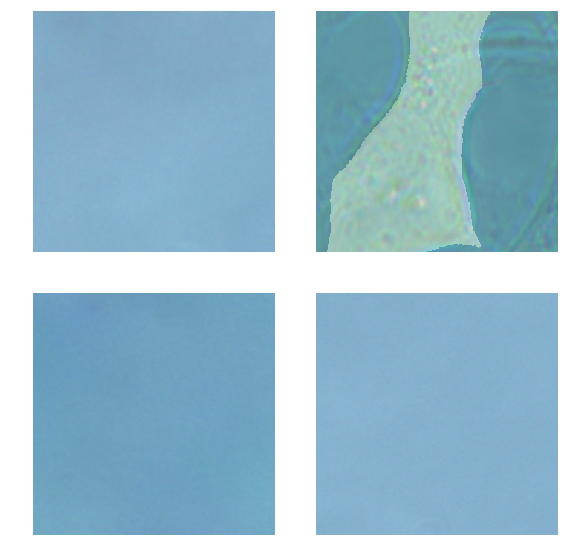

In [8]:
learner.data.show_batch(9)

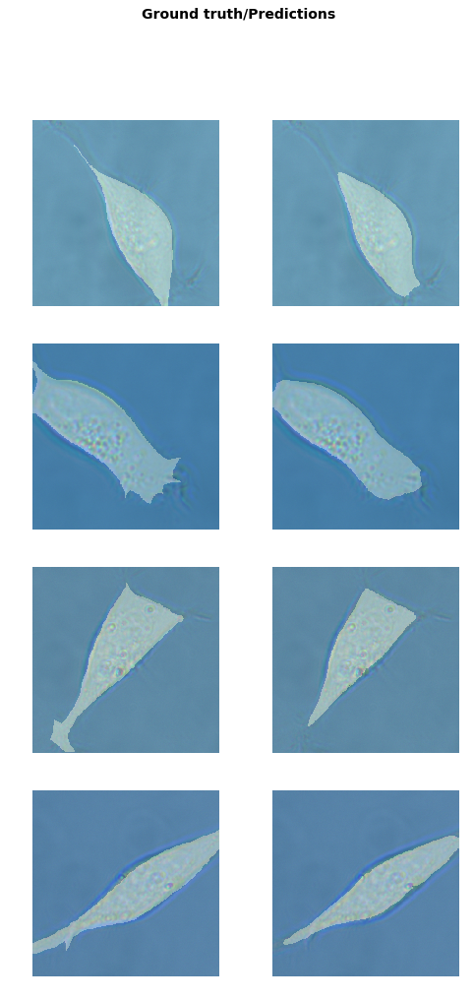

In [9]:
learner.show_results(5, 5)

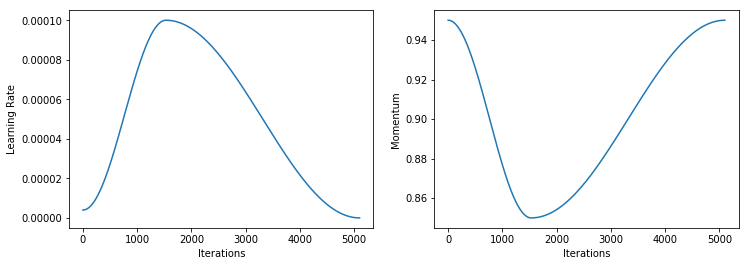

In [10]:
learner.recorder.plot_lr(show_moms = True)

<a id='training_tester'></a>
# Multimodel Trainer (For comparing models)

There are many things that you can compare including:
- Dropout Rate
- Channels used
- Special Drouput (Merge)
- Model used
- Image size


In [ ]:
""" 

The format for the trainer is:
(Name, Channel Codes, Dropout_rate, Special_Dropout_Rate)

Name - String describing the current training

ex. ('Fluorescence', [0,3,6], 0.3, 0.7)



#Note dropout will only be performed if you add 200 to the channel
#Special Dropout will only be performed if you choose a special merge (ex. code 111 or 311 for the dropout option)


100: #Merge All Fluorescence Channels
101: #Random Lower BR Channel
102: #Random Upper BR Channel
103: #Random BR Channel
104: #Merge all BR Channels
107: #Any random channels
110: #Black Channel
111: #Drouput merge




"""

In [34]:
"""Template 1: Each channel has its own parameters"""


TRAINING_CHANNELS = [('Fluorescence', [0,3,6], 0, 0), #fluorescence
                     ('Low Brightfield' , [11,12,13], 0, 0), #Low OoF Brightfield
                     ('Med Brightfield' ,[10,12,14], 0, 0), #Med OoF Brightfield
                     ('High Brightfield' , [9,12,15], 0, 0), #High OoF Brightfield
                     ('Merge and Brightfield' , [100, 12, 13], 0, 0), #Merge and Brightfield
                     ('All Black', [110, 110, 110], 0, 0), #All Black
                     ('All Random' , [107, 107, 107] ,0, 0), #All Random
                     ('All Infocus BR' , [12, 12, 12], 0, 0), #Only In-focus Brightfield
                     ('RND Brightfield Above and Below', [101, 12, 102],0,0),
                     ('Dropout Fluorescence Merge and Brightfield', [111, 12, 13], 0, 0),
                     ('Dropout Fluorescence', [200,203,206], 0, 0)
                    ]

In [7]:
""" Template 2: List Comprehension to generate dropout for fluorescence"""

dropout_array = np.arange(0,1.1,0.1)

TRAINING_CHANNELS = [('Dropout Fluorescence', [200,203,206], x, 0) for x in dropout_array] + [('All Black', [110, 110, 110], 0, 0)]



In [7]:
dropout_array = np.arange(0,1.1,0.1)

TRAINING_CHANNELS = [('Dropout Channel 1', [200,110,110], x, 0) for x in dropout_array] + [('All Black', [110, 110, 110], 0, 0)]



In [ ]:
""" Template 3: List comprehension for special dropout"""

special_dropout_array = np.arange(0,1.1,0.1)

TRAINING_CHANNELS = [('Dropout Fluorescence Merge and Brightfield', 
                      [111, 12, 13], 0, x) for x in special_dropout_array] + [('All Black', [110, 110, 110], 0, 0)]


In [61]:
""" Figure 2a Template """

TRAINING_CHANNELS = [('Fluorescence', [0,3,6], 0, 0), #fluorescence
                     ('Channel 1', [0,110,110], 0, 0), #fluorescence
                     ('Channel 2', [110,3,110], 0, 0), #fluorescence
                     ('Channel 3', [110,110,6], 0, 0), #fluorescence
                     ('All Random' , [107, 107, 107] ,0, 0), #All Random
                     ('All Infocus BR' , [12, 12, 12], 0, 0), #Only In-focus Brightfield
                     ('All Black', [110, 110, 110], 0, 0), #All Black
                    ]

In [19]:
""" Figure 3a Template INS1E """
#root_path = Path(r'C:\Users\Rocheleau Microscope\.fastai\data\Mask Trainer - INS1E')


root_path = Path(r"C:\Users\William\.fastai\data\Mask Trainer - AD293")
TRAINING_CHANNELS = [('All Infocus BR' , [12, 12, 12], 0, 0), # Only In-focus Brightfield
                     ('Low OoF' , [11, 12, 13], 0, 0), # Low OoF
                     ('Med OoF' , [10, 12, 14], 0, 0), # Medium OoF
                     ('High OoF' , [9, 12, 15], 0, 0), # High OoF
                     ('RND Brightfield Above and Below', [101, 12, 102],0,0),
                     ('All Black', [110, 110, 110], 0, 0), #All Black
                    ]

In [9]:
root_path = Path(r"C:\Users\William\.fastai\data\Mask Trainer - AD293")
data = None

In [10]:
""" Figure 3a Template """
TRAINING_CHANNELS = [('All Infocus BR' , [12, 12, 12], 0, 0), # Only In-focus Brightfield
                     ('Low OoF' , [11, 12, 13], 0, 0), # Low OoF
                     ('Med OoF' , [10, 12, 14], 0, 0), # Medium OoF
                     ('High OoF' , [9, 12, 15], 0, 0), # High OoF
                     ('RND Brightfield Above and Below', [101, 12, 102],0,0),
                     ('All Black', [110, 110, 110], 0, 0), #All Black
                    ]

In [44]:
""" Figure 4 Template """
dropout = 0.2
dropout2 = 0.6
dropout3 = 0.0

TRAINING_CHANNELS = [('RND Brightfield Above and Below', [101, 12, 102],0,0),
                     ('Merge and Brightfield' , [111, 12, 102], 0, dropout), #Merge and Brightfield
                     ('Ch1 and Brightfield' , [200, 12, 102], dropout, 0), #Merge and Brightfield
                     ('Ch2 and Brightfield' , [203, 12, 102], dropout, 0), #Merge and Brightfield
                     ('Ch3 and Brightfield' , [206, 12, 102], dropout, 0), #Merge and Brightfield
                     ('Fluorescence', [200,203,206], dropout, 0), #fluorescence                     
                     ('All Black', [110, 110, 110], 0, 0), #All Black
                     ('RND Brightfield Above and Below', [101, 12, 102],0,0),
                     ('Merge and Brightfield' , [111, 12, 102], 0, dropout2), #Merge and Brightfield
                     ('Ch1 and Brightfield' , [200, 12, 102], dropout2, 0), #Merge and Brightfield
                     ('Ch2 and Brightfield' , [203, 12, 102], dropout2, 0), #Merge and Brightfield
                     ('Ch3 and Brightfield' , [206, 12, 102], dropout2, 0), #Merge and Brightfield
                     ('Fluorescence', [200,203,206], dropout2, 0), #fluorescence                     
                     ('All Black2', [110, 110, 110], 0, 0), #All Black
                     ('RND Brightfield Above and Below', [101, 12, 102],0,0),
                     ('Merge and Brightfield' , [111, 12, 102], 0, dropout3), #Merge and Brightfield
                     ('Ch1 and Brightfield' , [200, 12, 102], dropout3, 0), #Merge and Brightfield
                     ('Ch2 and Brightfield' , [203, 12, 102], dropout3, 0), #Merge and Brightfield
                     ('Ch3 and Brightfield' , [206, 12, 102], dropout3, 0), #Merge and Brightfield
                     ('Fluorescence', [200,203,206], dropout3, 0), #fluorescence                     
                     ('All Black2', [110, 110, 110], 0, 0), #All Black
                    ]

In [10]:
#data = get_data(root_path = root_path, tfms=tfms, size = size, bs=bs)
#data.save(root_path/'Dataset5.pkl')
data = load_data(root_path, 'Dataset6.pkl', num_workers = 0, bs = bs)

C:\Users\William\Anaconda3\lib\site-packages\imageio\plugins\_tifffile.py:7285: UserWarning: module 'imageio.plugins._tifffile' has no attribute 'decode_packbits'
  Functionality might be degraded or be slow.

  warnings.warn("%s%s" % (e, warn))
C:\Users\William\Anaconda3\lib\site-packages\imageio\plugins\_tifffile.py:7285: UserWarning: module 'imageio.plugins._tifffile' has no attribute 'decode_lzw'
  Functionality might be degraded or be slow.

  warnings.warn("%s%s" % (e, warn))
C:\Users\William\Anaconda3\lib\site-packages\imageio\plugins\_tifffile.py:7285: UserWarning: module 'imageio.plugins._tifffile' has no attribute 'unpack_ints'
  Functionality might be degraded or be slow.

  warnings.warn("%s%s" % (e, warn))
C:\Users\William\Anaconda3\lib\site-packages\imageio\plugins\_tifffile.py:7285: UserWarning: module 'imageio.plugins._tifffile' has no attribute 'reverse_bitorder'
  Functionality might be degraded or be slow.

  warnings.warn("%s%s" % (e, warn))


In [7]:
dropout_array = np.arange(0,1.2,0.2)

TRAINING_CHANNELS = ([('RND Brightfield Above and Below', [101, 12, 102], 0, x) for x in dropout_array]
                    +[('Merge and Brightfield' , [111, 12, 102], 0, x) for x in dropout_array]
                    +[('Ch1 and Brightfield' , [200, 12, 102], 0, x) for x in dropout_array]
                    +[('Ch2 and Brightfield' , [203, 12, 102], 0, x) for x in dropout_array]
                    +[('Ch3 and Brightfield' , [206, 12, 102], 0, x) for x in dropout_array]
                     + [('Dropout Fluorescence', [200,203,206], x, 0) for x in dropout_array])

In [12]:
TRAINING_CHANNELS = [('Dropout Fluorescence', [200,203,206], x, 0) for x in dropout_array] + [('All Black', [110, 110, 110], 0, 0)]

In [10]:
dropout_array = np.arange(0,1.1,0.1)

TRAINING_CHANNELS = [(f'Merge and Brightfield {x}', [111,12,102], 0, x) for x in dropout_array] + [('All Black', [110, 110, 110], 0, 0)]


In [ ]:
dropout_array = np.arange(0,1.1,0.1)

TRAINING_CHANNELS = [('Dropout Fluorescence', [200,203,206], x, 0) for x in dropout_array] + [('All Black', [110, 110, 110], 0, 0)]


In [20]:
data = None

In [21]:
#Choose your root path here...
root_figures_path = root_path/'Figures'; root_figures_path.mkdir(exist_ok = True)



now = datetime.datetime.now()
counter = 0
while (root_figures_path/f"{now.year}-{now.month}-{now.day} {_ if counter is None else counter}").exists():
    counter += 1
    
figures_path = root_figures_path/f"{now.year}-{now.month}-{now.day} {_ if counter is None else counter}"
figures_path.mkdir(exist_ok = True)





def output_dataframe (results, col_labels, output_path = 'test.csv'):
    results_df= pd.DataFrame(np.asarray(results).squeeze().T, columns = col_labels)
    results_df.to_csv(output_path)
    return results_df




loss_results = []
acc_results = []
final_acc = []


for name, training_channels, dropout, spec_dropout in TRAINING_CHANNELS:
    """Note: Special Dropout refers to the rate at which channels are dropped during the merging process
       Dropout rate refers to the rate at which  
        
    """
    print ('Currently working on', name, training_channels, dropout, spec_dropout)

    #Note, these must be set so that they can interact properly with the trainer.  It would be better to pass them in
    CURRENT_CHANNELS = training_channels
    DROPOUT_RATE = dropout
    SPECIAL_DROPOUT_RATE = spec_dropout


    
    learner, cache = unet_trainer_program(root_path, 
                                      export_name = f'{name}.pkl',
                                      tfms = tfms, 
                                      bs = bs, 
                                      lr = lr, 
                                      size = size, 
                                      model = model,
                                      data = data,
                                      train_mode = True,  #Keep this as true since we are training
                                      return_cache = True,#Keep this as true
                                      penalty = penalty,
                                      #reuse_old_model = reuse_old_model,
                                      #old_model_name = old_model_name
                                     )

    
    loss_r = cache['Loss'] #np.asarray(learn.recorder.losses)
    acc_r = cache['Accuracy'] #np.asarray(learn.recorder.metrics)
    final_a = acc_r[-5:].mean()
    
    
    loss_results.append(loss_r)
    acc_results.append(acc_r)
    final_acc.append(final_a)
    

    np.savetxt(figures_path/f'Loss {name} {training_channels} {dropout}{spec_dropout}.txt', loss_r, delimiter = '\n')
    np.savetxt(figures_path/f'Accuracy {name} {training_channels} {dropout}{spec_dropout}.txt', acc_r, delimiter = '\n')
    #learn.export(model_path/f'{name}.pkl')
    
    
for (name, tc, _, _), accs in zip(TRAINING_CHANNELS, final_acc):
    print (name, tc, accs)
    
training_labels = [f"{x}, Dr{y}, SDr{z}" for (x, _, y, z) in TRAINING_CHANNELS]
training_labels


output_dataframe(acc_results, training_labels, figures_path/'acc_results.csv')
output_dataframe(loss_results, training_labels, figures_path/'loss_results.csv')

Currently working on All Infocus BR [12, 12, 12] 0 0


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.265091,0.394209,0.900339,01:06
1,0.262551,0.141125,0.917979,01:04
2,0.215601,0.115388,0.913945,01:04
3,0.214443,0.106761,0.925410,01:04
4,0.180067,0.109375,0.936470,01:04


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.146373,0.104718,0.938071,01:07
1,0.154777,0.102451,0.939620,01:06
2,0.144081,0.098875,0.940993,01:06
3,0.147444,0.105613,0.939020,01:07
4,0.153300,0.101392,0.941505,01:07
5,0.150062,0.101160,0.941972,01:06
6,0.138596,0.095514,0.942881,01:07
7,0.134656,0.090054,0.938203,01:07
8,0.143463,0.089604,0.940543,01:06
9,0.143932,0.088251,0.943927,01:07


Currently working on Low OoF [11, 12, 13] 0 0


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.327398,0.114450,0.915134,01:05
1,0.312128,0.127645,0.913596,01:06
2,0.244578,0.104733,0.926262,01:05
3,0.196071,0.109376,0.936319,01:05
4,0.168025,0.092532,0.935911,01:05


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.155664,0.098887,0.939286,01:08
1,0.154283,0.096251,0.940542,01:07
2,0.164695,0.093866,0.940533,01:07
3,0.146670,0.095649,0.940183,01:08
4,0.145897,0.093983,0.942702,01:07
5,0.140256,0.096416,0.943331,01:07
6,0.144851,0.086592,0.940541,01:08
7,0.140987,0.089759,0.945113,01:07
8,0.146773,0.093498,0.945962,01:07
9,0.140235,0.108274,0.944971,01:07


Currently working on Med OoF [10, 12, 14] 0 0


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.306728,0.161600,0.885310,01:06
1,0.260140,0.158609,0.892507,01:06
2,0.195971,0.140136,0.895624,01:06
3,0.164694,0.131915,0.894423,01:06
4,0.148725,0.149948,0.901716,01:05


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.140624,0.141071,0.906984,01:07
1,0.142111,0.146016,0.906730,01:06
2,0.154461,0.145377,0.905766,01:08
3,0.137067,0.135212,0.910822,01:07
4,0.133497,0.148664,0.906902,01:07
5,0.144793,0.155727,0.905183,01:07
6,0.131979,0.139787,0.910439,01:06
7,0.134333,0.125676,0.915851,01:07
8,0.128699,0.125020,0.918622,01:07
9,0.141646,0.141048,0.913804,01:07


Currently working on High OoF [9, 12, 15] 0 0


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.243413,0.168248,0.880662,01:06
1,0.221982,0.292619,0.858877,01:05
2,0.218345,0.183355,0.878340,01:05
3,0.175438,0.175892,0.894836,01:05
4,0.157559,0.137692,0.880606,01:05


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.142655,0.137043,0.889370,01:07
1,0.138076,0.137139,0.900561,01:06
2,0.142259,0.138456,0.898467,01:07
3,0.131596,0.140912,0.891043,01:07
4,0.128036,0.137215,0.898567,01:07
5,0.136726,0.139242,0.908217,01:07
6,0.134622,0.141473,0.909631,01:06
7,0.132499,0.130046,0.900641,01:07
8,0.136851,0.134317,0.892552,01:07
9,0.126866,0.138254,0.892032,01:08


Currently working on RND Brightfield Above and Below [101, 12, 102] 0 0


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.293765,0.110315,0.932879,01:05
1,0.279687,0.148259,0.926726,01:06
2,0.233136,0.105946,0.925848,01:05
3,0.189237,0.103752,0.931732,01:05
4,0.174445,0.097391,0.936562,01:05


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.143086,0.100662,0.933854,01:07
1,0.164827,0.097324,0.938154,01:08
2,0.168554,0.103306,0.934060,01:07
3,0.157618,0.092557,0.943822,01:08
4,0.152632,0.094777,0.940974,01:07
5,0.157065,0.098670,0.937891,01:07
6,0.156328,0.091469,0.942899,01:07
7,0.139230,0.120542,0.930474,01:08
8,0.142497,0.097296,0.942196,01:07
9,0.145879,0.095561,0.944607,01:08


Currently working on All Black [110, 110, 110] 0 0


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.312308,0.296978,0.876892,01:05
1,0.325355,0.261814,0.876892,01:05
2,0.303855,0.228628,0.876892,01:05
3,0.296102,0.243978,0.876892,01:05
4,0.284899,0.228140,0.876892,01:05


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.260405,0.230240,0.876892,01:07
1,0.273956,0.230332,0.876892,01:07
2,0.269434,0.229386,0.876892,01:06
3,0.282516,0.232211,0.876892,01:08
4,0.282385,0.232131,0.876892,01:07
5,0.279199,0.233197,0.876892,01:08
6,0.287441,0.243988,0.876892,01:08
7,0.291222,0.238212,0.876892,01:08
8,0.287868,0.233785,0.876892,01:08
9,0.293271,0.245218,0.876892,01:07


All Infocus BR [12, 12, 12] 0.9503787
Low OoF [11, 12, 13] 0.96088946
Med OoF [10, 12, 14] 0.9465596
High OoF [9, 12, 15] 0.9339975
RND Brightfield Above and Below [101, 12, 102] 0.9661994
All Black [110, 110, 110] 0.8768924


,"All Infocus BR, Dr0, SDr0","Low OoF, Dr0, SDr0","Med OoF, Dr0, SDr0","High OoF, Dr0, SDr0","RND Brightfield Above and Below, Dr0, SDr0","All Black, Dr0, SDr0"
0,1.093902,0.959691,0.536834,0.438683,0.913668,0.700357
1,0.953801,0.849589,0.467542,0.384850,0.802011,0.663079
2,0.806998,0.763936,0.455223,0.429048,0.729368,0.620624
3,0.788166,0.688483,0.420713,0.546605,0.660165,0.614699
4,0.690922,0.622805,0.387195,0.460117,0.611838,0.582794
5,0.621675,0.556541,0.350171,0.476029,0.570435,0.545435
6,0.555593,0.524896,0.315253,0.422662,0.551823,0.539163
7,0.542536,0.498180,0.315812,0.397946,0.517607,0.504869
8,0.492867,0.483873,0.421704,0.395007,0.534985,0.486694
9,0.472464,0.435970,0.381134,0.404815,0.600116,0.468172


In [22]:
#torch.cuda.empty_cache(); del data, learner; torch.cuda.empty_cache()

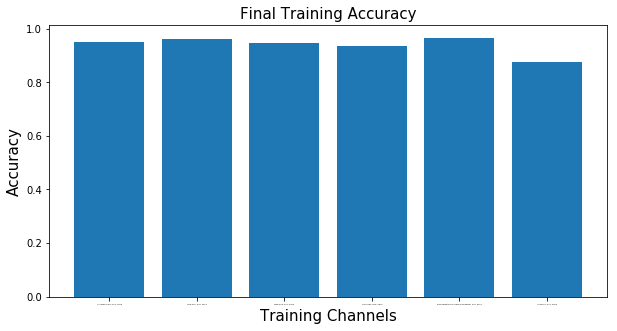

In [23]:
#Accuracy Plot
training_labels = [f"{x}, Dr{y}, SDr{z}" for (x, _, y, z) in TRAINING_CHANNELS]
training_labels


num_labels = len(final_acc)

plt.figure(figsize = (10,5))
plt.bar(range(num_labels), final_acc)
plt.xticks(range(num_labels), training_labels, fontsize = 2)
plt.ylabel("Accuracy", fontsize = 15)
plt.xlabel ("Training Channels", fontsize = 15)
plt.title("Final Training Accuracy", fontsize = 15)
plt.savefig(figures_path/'accuracy.eps', format = 'eps' )
plt.savefig(figures_path/'accuracy.png', format = 'png' )



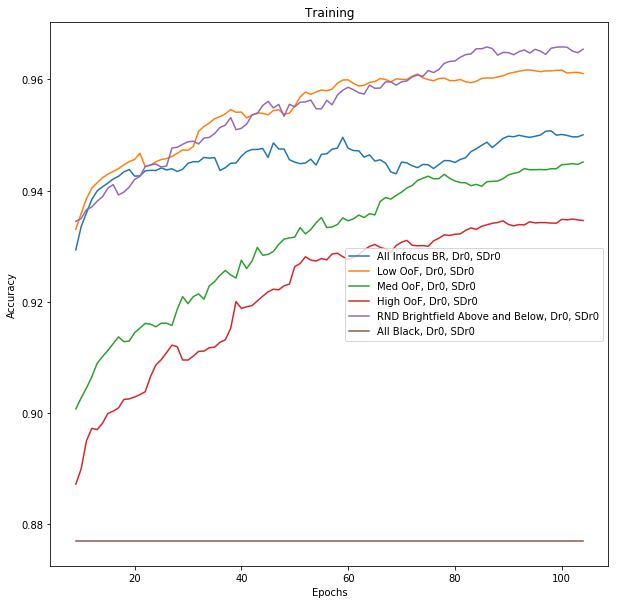

In [24]:
rolling_window = 10
plt.figure(figsize = (10,10))
plt.title("Training")
for i, label in enumerate(training_labels):
    if rolling_window:
        plt.plot(pd.Series(acc_results[i].squeeze()).rolling(rolling_window).mean(), label = label)
    else: plt.plot(acc_results[i], label = label)
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(loc = 0)
plt.savefig(figures_path/'train_accuracy.eps', format = 'eps' )
plt.savefig(figures_path/'train_accuracy.png', format = 'png' )

In [32]:
root_path = Path(r"C:\Users\William\.fastai\data\Mask Trainer - INS1E")
data = None

In [67]:
""" Figure 2a Template """
dropout = 0.0
TRAINING_CHANNELS = [('RND Brightfield Above and Below', [101, 12, 102],0,0),
                     ('Merge and Brightfield' , [111, 12, 102], 0, dropout), #Merge and Brightfield
                     ('Ch1 and Brightfield' , [200, 12, 102], dropout, 0), #Merge and Brightfield
                     ('Ch2 and Brightfield' , [203, 12, 102], dropout, 0), #Merge and Brightfield
                     ('Ch3 and Brightfield' , [206, 12, 102], dropout, 0), #Merge and Brightfield
                     ('Fluorescence', [200,203,206], dropout, 0), #fluorescence                     
                     ('All Black', [110, 110, 110], 0, 0), #All Black
                    ]


In [72]:
data = load_data(root_path, 'Dataset3.pkl', num_workers = 0, bs = bs)

In [33]:
#Choose your root path here...
root_figures_path = root_path/'Figures'; root_figures_path.mkdir(exist_ok = True)



now = datetime.datetime.now()
counter = 0
while (root_figures_path/f"{now.year}-{now.month}-{now.day} {_ if counter is None else counter}").exists():
    counter += 1
    
figures_path = root_figures_path/f"{now.year}-{now.month}-{now.day} {_ if counter is None else counter}"
figures_path.mkdir(exist_ok = True)





def output_dataframe (results, col_labels, output_path = 'test.csv'):
    results_df= pd.DataFrame(np.asarray(results).squeeze().T, columns = col_labels)
    results_df.to_csv(output_path)
    return results_df




loss_results = []
acc_results = []
final_acc = []


for name, training_channels, dropout, spec_dropout in TRAINING_CHANNELS:
    """Note: Special Dropout refers to the rate at which channels are dropped during the merging process
       Dropout rate refers to the rate at which  
        
    """
    print ('Currently working on', name, training_channels, dropout, spec_dropout)

    #Note, these must be set so that they can interact properly with the trainer.  It would be better to pass them in
    CURRENT_CHANNELS = training_channels
    DROPOUT_RATE = dropout
    SPECIAL_DROPOUT_RATE = spec_dropout


    
    learner, cache = unet_trainer_program(root_path, 
                                      export_name = f'{name}.pkl',
                                      tfms = tfms, 
                                      bs = bs, 
                                      lr = lr, 
                                      size = size, 
                                      model = model,
                                      data = data,
                                      train_mode = True,  #Keep this as true since we are training
                                      return_cache = True,#Keep this as true
                                      penalty = penalty,
                                      #reuse_old_model = reuse_old_model,
                                      #old_model_name = old_model_name
                                     )

    
    loss_r = cache['Loss'] #np.asarray(learn.recorder.losses)
    acc_r = cache['Accuracy'] #np.asarray(learn.recorder.metrics)
    final_a = acc_r[-5:].mean()
    
    
    loss_results.append(loss_r)
    acc_results.append(acc_r)
    final_acc.append(final_a)
    

    np.savetxt(figures_path/f'Loss {name} {training_channels} {dropout}{spec_dropout}.txt', loss_r, delimiter = '\n')
    np.savetxt(figures_path/f'Accuracy {name} {training_channels} {dropout}{spec_dropout}.txt', acc_r, delimiter = '\n')
    #learn.export(model_path/f'{name}.pkl')
    
    
for (name, tc, _, _), accs in zip(TRAINING_CHANNELS, final_acc):
    print (name, tc, accs)
    
training_labels = [f"{x}, Dr{y}, SDr{z}" for (x, _, y, z) in TRAINING_CHANNELS]
training_labels


output_dataframe(acc_results, training_labels, figures_path/'acc_results.csv')
output_dataframe(loss_results, training_labels, figures_path/'loss_results.csv')

Currently working on All Infocus BR [12, 12, 12] 0 0


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.379604,0.218790,0.858112,01:08
1,0.286208,0.145228,0.905187,01:05
2,0.218244,0.183583,0.910042,01:06
3,0.196127,0.143559,0.919310,01:07
4,0.170105,0.136465,0.918698,01:04


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.170411,0.131315,0.918509,01:08
1,0.173920,0.152341,0.921151,01:08
2,0.166721,0.133311,0.920553,01:09
3,0.161722,0.136287,0.921002,01:10
4,0.160194,0.137209,0.922271,01:08
5,0.162988,0.133655,0.920920,01:07
6,0.146458,0.129103,0.921591,01:07
7,0.152186,0.127397,0.920421,01:09
8,0.165145,0.133117,0.924431,01:08
9,0.155618,0.128542,0.922760,01:09


Currently working on Low OoF [11, 12, 13] 0 0


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.479347,0.178856,0.863751,01:07
1,0.300901,0.224526,0.897896,01:11
2,0.269070,0.230710,0.885591,01:09
3,0.220792,0.133251,0.909623,01:08
4,0.191558,0.132433,0.920283,01:06


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.188766,0.132530,0.920049,01:11
1,0.178469,0.127749,0.919679,01:08
2,0.163645,0.127565,0.919711,01:09
3,0.172337,0.123864,0.918442,01:12
4,0.160158,0.124672,0.922440,01:13
5,0.163020,0.123947,0.922391,01:09
6,0.157968,0.124631,0.927705,01:09
7,0.168017,0.119756,0.923653,01:10
8,0.145724,0.122024,0.928576,01:10
9,0.143171,0.116719,0.922634,01:10


Currently working on Med OoF [10, 12, 14] 0 0


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.281370,0.174830,0.893164,01:06
1,0.268743,0.184541,0.873339,01:05
2,0.219585,0.182480,0.886712,01:05
3,0.183009,0.167365,0.899350,01:06
4,0.178259,0.165139,0.901274,01:06


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.165401,0.163023,0.900068,01:07
1,0.147494,0.162985,0.900825,01:07
2,0.142645,0.158545,0.901351,01:07
3,0.148705,0.157986,0.903373,01:08
4,0.149456,0.156524,0.901357,01:08
5,0.150063,0.151531,0.906247,01:08
6,0.156026,0.152512,0.909391,01:08
7,0.150440,0.152654,0.910931,01:07
8,0.138123,0.150377,0.912158,01:07
9,0.130711,0.146482,0.914636,01:07


Currently working on High OoF [9, 12, 15] 0 0


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.351801,0.147821,0.881170,01:06
1,0.264950,0.135443,0.908447,01:06
2,0.224058,0.143687,0.872845,01:06
3,0.190367,0.173447,0.916981,01:05
4,0.181941,0.125217,0.919350,01:06


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.151455,0.126451,0.921088,01:07
1,0.160070,0.127757,0.924318,01:07
2,0.159008,0.124060,0.925572,01:07
3,0.162102,0.130996,0.920381,01:08
4,0.162111,0.122855,0.920181,01:08
5,0.152904,0.127684,0.924958,01:07
6,0.151057,0.120690,0.918409,01:07
7,0.141445,0.120581,0.910710,01:07
8,0.153591,0.121370,0.901523,01:07
9,0.153948,0.120183,0.930318,01:07


Currently working on RND Brightfield Above and Below [101, 12, 102] 0 0


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.437558,0.262213,0.868151,01:05
1,0.286450,0.149752,0.927442,01:05
2,0.248760,0.123452,0.922084,01:05
3,0.199094,0.129002,0.928373,01:05
4,0.182816,0.115981,0.928210,01:05


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.184093,0.126818,0.929530,01:08
1,0.161634,0.120788,0.931948,01:07
2,0.157769,0.118845,0.926082,01:07
3,0.156396,0.125779,0.926807,01:07
4,0.173394,0.118527,0.933514,01:07
5,0.177929,0.115580,0.927965,01:08
6,0.173710,0.108400,0.927058,01:06
7,0.165325,0.114379,0.919738,01:07
8,0.161338,0.117216,0.933318,01:07
9,0.150583,0.110459,0.936980,01:07


Currently working on All Black [110, 110, 110] 0 0


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.447347,0.346790,0.845030,01:05
1,0.411220,0.268500,0.845030,01:06
2,0.418477,0.272663,0.845030,01:05
3,0.395740,0.281803,0.845030,01:06
4,0.379890,0.288360,0.845030,01:05


epoch,train_loss,valid_loss,acc_segmentation,time
0,0.371504,0.274859,0.845030,01:07
1,0.386697,0.276440,0.845030,01:08
2,0.389128,0.278399,0.845030,01:07
3,0.377796,0.269094,0.845030,01:07
4,0.378827,0.271183,0.845030,01:07
5,0.379792,0.267048,0.845030,01:07
6,0.381612,0.273528,0.845030,01:07
7,0.375181,0.263205,0.845030,01:07
8,0.379044,0.272729,0.845030,01:07
9,0.390316,0.283226,0.845030,01:07


All Infocus BR [12, 12, 12] 0.9528738
Low OoF [11, 12, 13] 0.9657915
Med OoF [10, 12, 14] 0.95611703
High OoF [9, 12, 15] 0.95878154
RND Brightfield Above and Below [101, 12, 102] 0.961733
All Black [110, 110, 110] 0.84502983


,"All Infocus BR, Dr0, SDr0","Low OoF, Dr0, SDr0","Med OoF, Dr0, SDr0","High OoF, Dr0, SDr0","RND Brightfield Above and Below, Dr0, SDr0","All Black, Dr0, SDr0"
0,0.845012,2.530765,0.736656,0.996847,1.560402,0.659438
1,0.791976,2.266528,0.629429,0.919195,1.371403,0.576542
2,0.742449,2.034734,0.583511,0.845559,1.222230,0.562037
3,0.708973,1.903927,0.543509,0.792104,1.118086,0.511314
4,0.683420,1.784215,0.521986,0.741784,1.030268,0.457659
5,0.668840,1.687548,0.521904,0.739643,0.961329,0.433327
6,0.646678,1.624222,0.527328,0.680084,0.941717,0.452044
7,0.626117,1.534491,0.535339,0.641880,0.893540,0.408732
8,0.614014,1.483606,0.509976,0.603348,0.862795,0.375605
9,0.581962,1.402676,0.491176,0.597185,0.817327,0.343589


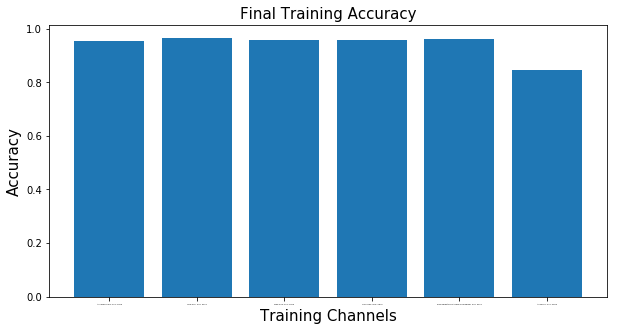

In [34]:
#Accuracy Plot
training_labels = [f"{x}, Dr{y}, SDr{z}" for (x, _, y, z) in TRAINING_CHANNELS]
training_labels


num_labels = len(final_acc)

plt.figure(figsize = (10,5))
plt.bar(range(num_labels), final_acc)
plt.xticks(range(num_labels), training_labels, fontsize = 2)
plt.ylabel("Accuracy", fontsize = 15)
plt.xlabel ("Training Channels", fontsize = 15)
plt.title("Final Training Accuracy", fontsize = 15)
plt.savefig(figures_path/'accuracy.eps', format = 'eps' )
plt.savefig(figures_path/'accuracy.png', format = 'png' )



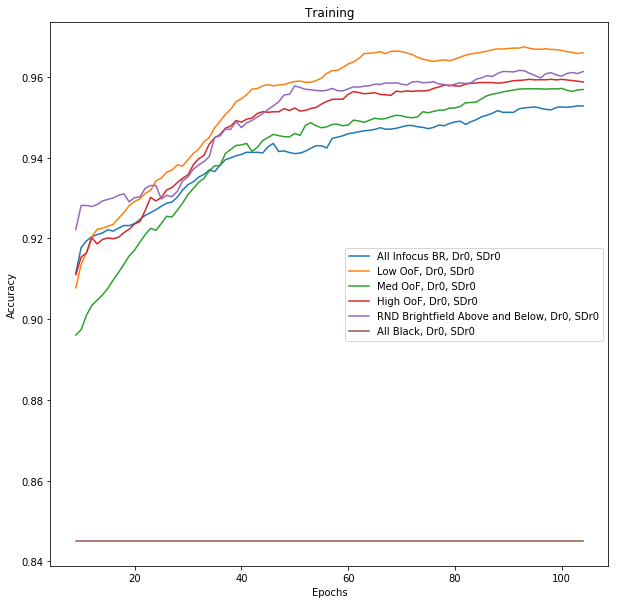

In [35]:
rolling_window = 10
plt.figure(figsize = (10,10))
plt.title("Training")
for i, label in enumerate(training_labels):
    if rolling_window:
        plt.plot(pd.Series(acc_results[i].squeeze()).rolling(rolling_window).mean(), label = label)
    else: plt.plot(acc_results[i], label = label)
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(loc = 0)
plt.savefig(figures_path/'train_accuracy.eps', format = 'eps' )
plt.savefig(figures_path/'train_accuracy.png', format = 'png' )

In [36]:
learner.data.save(root_path/'Dataset2OoF.pkl')

<a id='transformation_tester'></a>
## Test your transformations

- Step 1: Choose the example image and set example_image_path to its path

- Step 2: Set your transformation parameters in either the relevant transformation explorer

- Step 3: Run that cell

In [9]:
root_path = Path(r"C:\Users\Rocheleau Microscope\.fastai\data\Mask Trainer")
root_path = Path(r'C:\Users\William\.fastai\data\Mask Trainer')

example_image_path = root_path/r'FullImage'/r'INS1E\20190307W\1_1_MMStack_Pos03.ome.tif'
example_image_path = Path(r"C:\Users\Rocheleau Microscope\.fastai\data\Mask Trainer\FullImage\INS1E\20190307W\1_1_MMStack_Pos03.ome.tif")
example_image_path = Path(r"C:\Users\Rocheleau Microscope\.fastai\data\Mask Trainer\FullImage\AD293\20190318AD293Cindy\1_15_MMStack_Pos00.ome.tif")

def get_example_image():
    return open_image_2(example_image_path)

def get_img(): return open_image_2(example_image_path)

def plots_f(rows, cols, width, height, **kwargs):
    
    [get_example_image().apply_tfms(custom_tfms, padding_mode = 'border', **kwargs).show(ax=ax) for i,ax in enumerate(plt.subplots(
        rows,cols,figsize=(width,height))[1].flatten())]

    
def plots_f(rows, cols, width, height, **kwargs):
    fig, axes = plt.subplots(rows,cols,figsize=(width,height))
    [get_example_image().apply_tfms(custom_tfms, padding_mode = 'border', **kwargs).show(ax=ax) for i,ax in enumerate(axes.flatten())]
    return fig
        
    
def one_hot_encoding_array (x, scale=1):
    array = torch.tensor(np.zeros(8))
    array[x] = scale
    return array

### Transformation Explorer (Apply All)

This cell will apply your transformations to your example image (found in example_image_path)

In [15]:
CURRENT_CHANNELS = [0,3,6]
custom_tfms = [#pad(padding=(4), mode = 'zeros', p=0.5),
               #pad(padding=(2), mode = 'zeros', p=0.5),
               #rand_crop(padding_mode = 'zeros', p=0.2),
               rotate(degrees=(-180,180), p=1.),
               brightness(change = (0.3,0.65), p = 0.8),
               contrast(scale = (0.75, 1.25), p = 0.8),
                   #jitter(magnitude = 1.0, p = 1.0),
               symmetric_warp(magnitude = (0,0.5), p = 1.0),
               rand_zoom(scale = (1.0, 1.1), p=1.0),
               dihedral(p = 1.0),
               
               #add skew
              ]




fig = plots_f(4,4,400,400)

plt.savefig('all_fluoro2.svg')


<Figure size 432x288 with 0 Axes>

### Transformation Explorer (Apply Individually)

Step 1: Run the cell for the transformations that you wake

In [ ]:
""" Template 1: Default Transforms from get_transforms() """

do_flip=True
flip_vert=False
max_rotate=10.
max_zoom=1.1
max_lighting=0.2
max_warp=0.2
p_affine=0.75
p_lighting=0.75

ntests = 10
DIRECT_TFMS = {("Brightness", brightness): [{'change': x, 'p':p_lighting} for x in np.linspace(0.4,0.6,num=ntests)], 
               ("Contrast", contrast):[{'scale': x, 'p':p_lighting} for x in np.linspace(1-max_lighting,1/(1-max_lighting),num = ntests)], 
#               ('Crop', crop):[{'size':(sz, sz), 'row_pct':0.9, 'col_pct':0.9} for sz in range(200,500,50)],
#               ('Crop Pad', crop_pad):[{'size':sz, 'padding_mode':'zeros'} for sz in range (200, 700, 50)],
#               ('Dihedral', dihedral):[{'k':x} for x in range(8)],
               ('Flip LR', flip_lr):[{}],
#               ('Jitter', jitter):[{'magnitude':x} for x in np.linspace(0,0.5, ntests)],
#               ('Pad', pad):[{'padding':x, 'mode':'border'} for x in range(0,40,4)],
#               ('Perspective Warp Direction', perspective_warp):[{'magnitude':one_hot_encoding_array(x, 1)} 
#                                                                 for x in range(8)],
#               ('Perspective Warp Magnitude', perspective_warp):[{'magnitude':one_hot_encoding_array(0, x)} 
#                                                                 for x in np.linspace(0,1,ntests)],
               ('Rotate', rotate):[{'degrees':x} for x in np.linspace(-max_rotate,max_rotate, ntests)],
#               ('Skew Direction', skew): [{'direction':x, 'magnitude':2} for x in range(8)],
#               ('Skew Magnitude', skew): [{'direction':0, 'magnitude':x} for x in np.linspace(0,10,ntests)],
               ('Symmetric Warp', symmetric_warp): [{'magnitude':(x,0, 0, 0), 'p':p_affine} for x in np.linspace(-max_warp,max_warp, ntests)],
#                ('Symmetric Warp All', symmetric_warp): [{'magnitude':(x,x,x,x)} for x in np.linspace(0,1, ntests)],
               
              
             }


In [7]:
""" Template 2: Custom Transforms """

ntests = 10
DIRECT_TFMS = {("Brightness", brightness): [{'change': x} for x in np.linspace(0,1,num=ntests)], 
              ("Contrast", contrast):[{'scale': x} for x in np.linspace(0,1,num = ntests)], 
              ('Crop', crop):[{'size':(sz, sz), 'row_pct':0.9, 'col_pct':0.9} for sz in range(200,500,50)],
              ('Crop Pad', crop_pad):[{'size':sz, 'padding_mode':'border'} for sz in range (200, 700, 50)],
              ('Dihedral', dihedral):[{'k':x} for x in range(8)],
              ('Flip LR', flip_lr):[{}],
              ('Jitter', jitter):[{'magnitude':x} for x in np.linspace(0,0.5, ntests)],
              ('Pad', pad):[{'padding':x, 'mode':'border'} for x in range(0,40,4)],
              ('Perspective Warp Direction', perspective_warp):[{'magnitude':one_hot_encoding_array(x, 1)} 
                                                                for x in range(8)],
              ('Perspective Warp Magnitude', perspective_warp):[{'magnitude':one_hot_encoding_array(0, x)} 
                                                                for x in np.linspace(0,1,ntests)],
              ('Rotate', rotate):[{'degrees':x} for x in np.linspace(0,360, ntests)],
              ('Skew Direction', skew): [{'direction':x, 'magnitude':2} for x in range(8)],
              ('Skew Magnitude', skew): [{'direction':0, 'magnitude':x} for x in np.linspace(0,10,ntests)],
              ('Symmetric Warp One Side', symmetric_warp): [{'magnitude':(0,0,0,x)} for x in np.linspace(0,1, ntests)],
              ('Symmetric Warp All', symmetric_warp): [{'magnitude':(x,x,x,x)} for x in np.linspace(0,1, ntests)],
               
              
             }

In [ ]:
CURRENT_CHANNELS = [11,12,13]
x = open_image_2(example_image_path)


nrows = len(DIRECT_TFMS) #+ len(INDIRECT_TFMS)
ncols = ntests + 1
FONTSIZE = 30
c, h, w = get_img().shape

fig, ax = plt.subplots(nrows = nrows, ncols = ncols, figsize = (h,w))
#Direct Transformations
for row, ((name, tfm), parameters) in enumerate(DIRECT_TFMS.items()):
    for col, kwargs in enumerate(parameters):
        tfm(get_img(), **kwargs).show(ax[row][col])
        ax[row][col].set_title(str(kwargs), fontsize = FONTSIZE)
    ax[row][-1].text(0.1, 0.8, name, fontsize = FONTSIZE*3)
    ax[row][-1].text(0.1, 0.4, str(parameters[0]), fontsize = FONTSIZE*3)
    ax[row][-1].text(0.1, 0.1, str(parameters[-1]), fontsize = FONTSIZE*3)
    ax[row][-1].axis('off')

    
#fig.tight_layout()
fig.savefig('transform_map_brightfield2.svg')



<a id='batch_output'></a>
## Model Explorer

In [7]:
model_name = 'Fluorescence'
CURRENT_CHANNELS = [0,3,6]



mask_path = root_path/"Mask_Norm" ; mask_path.mkdir(exist_ok = True)
seg_path = root_path/"FullImage" ; #seg_path.mkdir(exist_ok = True)
codes_path = root_path/"codes.txt"
model_path = root_path/'Models' ; model_path.mkdir(exist_ok = True)
figures_path = root_path/'Figures' ; figures_path.mkdir(exist_ok = True)

learner, cache = unet_trainer_program(root_path, 
                                      tfms = tfms, 
                                      bs = bs, 
                                      lr = lr, 
                                      size = size, 
                                      model = model,
                                      export_name = export_name,
                                      train_mode = False,  
                                      return_cache = True, #This will return learn, cache instead of just learn
                                      reuse_old_model = reuse_old_model,
                                      output_cache = True,
                                      old_model_name = old_model_name,
                                      penalty = penalty, #High values will punish saying it's the bkgd and getting it wrong
                                       #This will load the weights from 
                                     )



learn = load_learner(model_path, model_name+'.pkl')
learn.data = learner.data


#Should be on the validation ds!!!
images = learner.data.train_ds.items
learn.callbacks.append(RecordOnCPU())
for filepath in images:
    img = open_image_2(filepath)
    pred = learn.predict(img)
    *callbacks,rec_cpu = learn.callbacks
    x,y = rec_cpu.input,rec_cpu.target
    
    fig,ax = plt.subplots()
    ax.imshow(image2np(x[0,...]), cmap=defaults.cmap, alpha=1)
    ax.imshow(image2np(pred[1].data), cmap=defaults.cmap, alpha=0.5)
    ax.axis('off')
    
    output_path = model_path/model_name/str(filepath.relative_to(seg_path)).replace('ome.tif', 'png')
    output_path.parent.mkdir(exist_ok = True, parents = True)
    plt.savefig(output_path)
    plt.close()
    
learn.destroy()
learner.destroy()


C:\Users\William\Anaconda3\lib\site-packages\imageio\plugins\_tifffile.py:7285: UserWarning: module 'imageio.plugins._tifffile' has no attribute 'decode_packbits'
  Functionality might be degraded or be slow.

  warnings.warn("%s%s" % (e, warn))
C:\Users\William\Anaconda3\lib\site-packages\imageio\plugins\_tifffile.py:7285: UserWarning: module 'imageio.plugins._tifffile' has no attribute 'decode_lzw'
  Functionality might be degraded or be slow.

  warnings.warn("%s%s" % (e, warn))
C:\Users\William\Anaconda3\lib\site-packages\imageio\plugins\_tifffile.py:7285: UserWarning: module 'imageio.plugins._tifffile' has no attribute 'unpack_ints'
  Functionality might be degraded or be slow.

  warnings.warn("%s%s" % (e, warn))
C:\Users\William\Anaconda3\lib\site-packages\imageio\plugins\_tifffile.py:7285: UserWarning: module 'imageio.plugins._tifffile' has no attribute 'reverse_bitorder'
  Functionality might be degraded or be slow.

  warnings.warn("%s%s" % (e, warn))


C:\Users\William\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


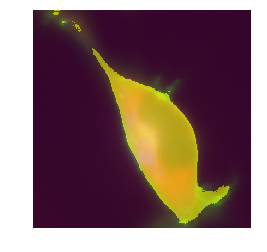

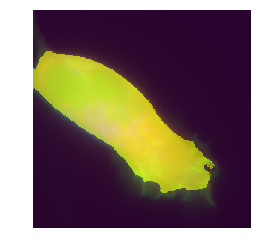

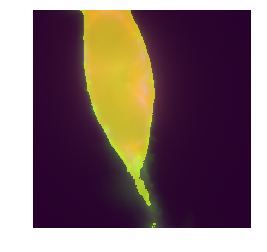

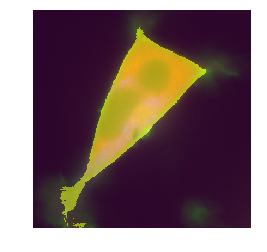

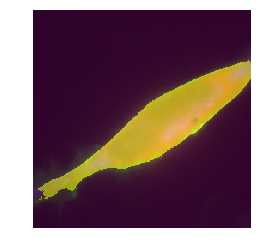

...

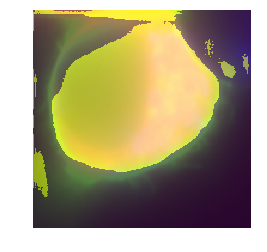

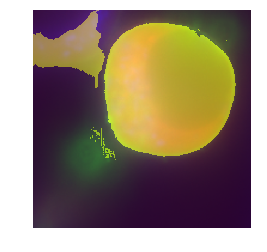

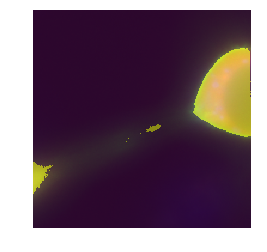

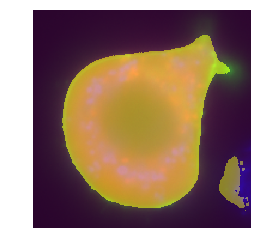

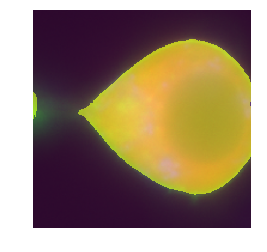

In [10]:
mask_path = root_path/"Mask_Norm" ; mask_path.mkdir(exist_ok = True)
seg_path = root_path/"FullImage" ; #seg_path.mkdir(exist_ok = True)
codes_path = root_path/"codes.txt"
model_path = root_path/'Models' ; model_path.mkdir(exist_ok = True)
figures_path = root_path/'Figures' ; figures_path.mkdir(exist_ok = True)

learn = load_learner(model_path, model_name+'.pkl')
learn.data = learner.data

In [93]:
y.shape

torch.Size([1])

In [ ]:
brightness(get_img(), 0.1)# 0-1
contrast(get_img(), 1) #0-Inf (1 is normal)
crop(get_img(), (500,500), row_pct = 0.9, col_pct = 0.9) #Don't use
crop_pad(get_img(), 500, padding_mode = 'zeros')
dihedral(get_img(), k=8) #There are 8
flip_lr(get_img())
jitter(get_img(), 0.5)  #Beyond 0.5 is too strong
pad(get_img(), padding = 20, mode = 'border')
magnitudes = torch.tensor(np.zeros(8))
magnitudes[0] = 1   #
perspective_warp(get_img(), magnitudes)
rotate(get_img(), 75)
#get_img().rgb_randomize(0, 0.2)  #Not implemented in my version
skew(get_img(), 0, 2)  #First number is direction, second is magnitude
get_img().tilt(0, 2)   #First number is direction, second is magnitude
get_img().zoom(1.2)


get_img().resize(1000).refresh()
get_img().squish(scale = 0.5) #
tfms = symmetric_warp(magnitude = (-0.1, -0.5))
get_img().apply_tfms(tfms, padding_mode = 'zeros')


get_img()

In [ ]:
symmetric_warp(get_img(), magnitude = (-0.1, -0.5, -0, 0))

In [ ]:
ax.axis['xzero'].set_label("x")

In [ ]:
fig, axes = plt.subplots(2,2)
get_img().show(axes[0][0])
axes[0][0].xaxis.set_visible(False)
axes[0][1].text(0.1,0.5,'Hello')
axes[0][1].axis('off')

In [ ]:
for transform in get_transforms()[0]:
    print (transform)

In [ ]:
example_image_path = root_path/r'FullImage'/r'1_10_MMStack_Pos02.ome.tif'

def get_example_image():
    return open_image_2(example_image_path)


def plot_individual_transforms(tfms, **kwargs):
    title_font_size = 25
    rows = columns = np.ceil(np.sqrt(len(tfms[0]))).astype('uint8')
    fig, axes = plt.subplots(rows, columns, figsize = (40,40))
    num_transforms = len(tfms[0])

    for i,ax in enumerate(axes.flatten()):

        if i == 0:   #Plot original image
            ax.set_title('Original Image', fontsize = title_font_size)
            get_example_image().show(ax=ax)


        elif i < (len(tfms[0])+1):
            ax.set_title(str(tfms[0][i-1])[27:54], fontsize = title_font_size)
            get_example_image().apply_tfms(tfms[0][i-1]).show(ax=ax)

        else:
            ax.axis('off')
            
    return (fig)

            
#From the FastAI Docs
def plots_f(rows, cols, width, height, **kwargs):
    [get_example_image().apply_tfms(tfms[0], **kwargs).show(ax=ax) for i,ax in enumerate(plt.subplots(
        rows,cols,figsize=(width,height))[1].flatten())]

In [ ]:
t1 = get_transforms(flip_vert=True)

fig = plot_individual_transforms(t1)
fig.savefig(root_path/'figure.eps', format = 'eps' )

In [ ]:
plots_f(2, 4, 12, 6, size=224)

In [ ]:


title_font_size = 25
rows = columns = np.ceil(np.sqrt(len(tfms[0]))).astype('uint8')
fig, axes = plt.subplots(rows, columns, figsize = (40,40))
num_transforms = len(tfms[0])

for i,ax in enumerate(axes.flatten()):
    
    if i == 0:   #Plot original image
        ax.set_title('Original Image', fontsize = title_font_size)
        get_example_image().show(ax=ax)
        
        
    elif i < (len(tfms[0])+1):
        ax.set_title(str(tfms[0][i-1])[27:54], fontsize = title_font_size)
        get_example_image().apply_tfms(tfms[0][i-1]).show(ax=ax)
    
    else:
        ax.axis('off')

In [ ]:
ax.reshape(-1).shape

<a id='model_tester'></a>
## Model Explorer (WIP - Not finished)

Note, this is still a work in progress.  The ultimate goal is to be able to explore the results of your training as well as to better understand how predictions work (for implementation in the analysis program)


There are two ways to predict an image once you have a trained learner: learn.predict() or learn.predict_batch() <br>

With the batch predict, your outputs will be in the form: 


- One batch will be in the form:
- one_batch[0] Contains all of the images   (Shape = [# images, 3, 200, 200]
- one_batch[1] Contains all of the masks
- one_batch[2] contains the probabilities

- The outputs will be in the form [image][mask]



For a single image, the outputs will be:
- dfsdf



In [ ]:
"""
Fetch one batch from the dataloader and predict the outputs

"""
batch_size = learner.data.batch_size

one_batch = next(iter(learner.dl(ds_type = DatasetType.Valid)))

outputs = learner.pred_batch(batch = one_batch)



In [ ]:
plt.imshow(outputs[2][0])

In [ ]:
"""
Fetch one item from the dataset
"""

image, mask = learner.data.train_ds[0]

output = learner.predict(image)

In [ ]:
len(output)

In [ ]:
for i in range( len(outputs)):
    print (i, ": ", len(outputs[i]), type(outputs[i]), outputs[i].shape)


In [ ]:
#Show the results of a batch


def rearranged_image(img):
    rearranged_image = np.asarray(img)
    rearranged_image = np.moveaxis(rearranged_image, 0, -1)
    return (rearranged_image)



num_images = batch_size

fig, ax = plt.subplots(num_images,3, figsize = (20,20))

for i in range(num_images):
    ax[i][0].imshow(rearranged_image(one_batch[0][i,:,:,:]))
    ax[i][1].imshow(one_batch[1][i,0,:,:])
    ax[i][2].imshow(rearranged_image(outputs[i]))




In [ ]:
#Show an entire batch...
rows = columns = np.sqrt(batch_size)


fig, axes = plt.subplots(rows,columns, figsize = (20,20))

axes_flat = axes.flatten()

for i in range(batch_size):
    axes_flat[i].imshow(outputs[1][i,0,:,:])
    

In [ ]:
img2 = open_image_2(example_image_path)
single_output = seg_learn.predict(img2)

## Test your imported models

In [ ]:
size = 400
mito_model = load_learner(Path(r'models'), 'mito-learn.pkl')

In [ ]:
filepath = Path(r"D:\[] ML Dataset\Datasets\2019-03-17 AD293 Dataset 24 Hours after Replating-Louise\Debug Outputs (Subcells)\2\0.ome.tif")

In [ ]:
img = open_image_2(filepath)

In [ ]:
CURRENT_CHANNELS = [0,1,2]
img = open_image_2(filepath)

In [ ]:
img.shape

In [ ]:
o1, o2, o3 = mito_model.predict(img)

In [ ]:
img

In [ ]:
plt.imshow(np.asarray(o2).squeeze())

In [ ]:
img2 = imageio.imread(str(filepath))

In [ ]:
image_array = np.asarray(img2)

In [ ]:
image_array.shape

In [ ]:
#img_array = open_image_array(np.moveaxis(img2, -1, 0))
img_array = open_image_array(img2)
img_array.shape

In [ ]:
CURRENT_CHANNELS = [9,12,15]  

In [ ]:
from skimage.measure import block_reduce

sz = 400
network = mito_model
data = image_array

h, w, c = data.shape
print(data.shape)
scale_factor = 1 + max(h//sz, w//sz)   
print ("Scale Factor is:", scale_factor, h//sz, w//sz)

if scale_factor > 1:
    padded_array = np.zeros((h+h%scale_factor,
                             w+w%scale_factor,
                             3))
    padded_array[:h,:w,:] = data
    data = block_reduce(padded_array, (scale_factor, scale_factor, 1), func = np.mean)


data = np.moveaxis(data, -1, 0)     #New shape is (3, sz, sz)

new_c, new_h, new_w = data.shape

print (f"Before the input array, shape is {data.shape}")


input_array = np.zeros((3,sz,sz))
input_array[:, :new_h, :new_w] = data.copy()

print ("In the input array", input_array.shape)




input_array =  open_image_array(input_array)
print ("After Open Image", input_array.shape)
(o1, o2, o3) = network.predict(input_array)

prediction = np.asarray(o2.squeeze())

if prediction.ndim == 2: prediction = np.expand_dims(prediction, 0)


print (f"The shape of the prediction is {prediction.shape}")


if scale_factor > 1:
    prediction = np.kron(prediction, np.ones((1, scale_factor, scale_factor)))

print("Right before segmentation the results are:", prediction.shape)
final_segmentation = prediction[0, :h, :w]>0

print ("The shape of the final segmentation is", final_segmentation.shape)
print ("The maximum value of the prediction is", np.amax(prediction))
print ("The mean value is: ", np.mean(prediction))


In [ ]:
plt.imshow(final_segmentation)

In [ ]:
final_segmentation.shape

In [ ]:
plt.imshow(np.multiply(image_array, np.expand_dims(final_segmentation, 2)))

In [ ]:
mito_model.predict(open_image_array(np.zeros(1,1)))

In [ ]:


test = open_image_array(np.ones((3,11,11)))

In [ ]:
o1, o2, o3 = mito_model.predict(test)

In [ ]:
o2.shape[2]

## Building it from Scratch

In [ ]:
CURRENT_CHANNELS = [0,3,6]   

#seg_path = Path(r"")

tfms = get_transforms(flip_vert = True)
size = 200

seg_data = (SegMultiImageList
          .from_folder(seg_path)
          .split_by_rand_pct()
          .label_from_func(get_y_func, classes = codes)
          .transform(tfms, size = size, tfm_y = True)
          .databunch(num_workers = 0, bs = 8))


In [ ]:
seg_data.show_batch(4)

In [ ]:
seg_learn = unet_learner(seg_data, models.resnet34, metrics = [acc_segmentation])

In [ ]:
lr_find(seg_learn)
seg_learn.recorder.plot()

In [ ]:
lr = 1e-4

In [ ]:
seg_learn.fit_one_cycle(5)

In [ ]:
seg_learn.fit_one_cycle(10)

seg_learn.unfreeze()

seg_learn.fit_one_cycle(100, slice(lr))
seg_learn.recorder.plot()

In [ ]:
plt.plot(np.asarray(seg_learn.recorder.metrics))

In [ ]:
seg_learn.show_results(3)

In [ ]:
np.asarray(seg_learn.recorder.metrics)
seg_learn.recorder.plot_metrics()

In [ ]:
plt.plot(np.asarray(seg_learn.recorder.lrs))

In [ ]:
seg_learn.save(model_path/'seg_test')

In [ ]:
seg_learn.export(model_path/'seg_exp.pkl')

## Helper Functions

<a id = 'lr_finder'></a>
### Find your learning rate

In [ ]:
learn, cache = unet_trainer_program(root_path, 
                                      tfms = tfms, 
                                      bs = bs, 
                                      lr = lr, 
                                      size = size, 
                                      model = model,
                                      train_mode = False,  
                                      return_cache = True, #This will return learn, cache instead of just learn
                                      reuse_old_model = reuse_old_model,
                                      old_model_name = old_model_name
                                     )


In [ ]:
CURRENT_CHANNELS = [0,3,6]
DROPOUT_RATE = 0
SPECIAL_DROPOUT_RATE = 0

In [ ]:
LR_CHANNELS = [('Fluorescence', [0,3,6]), #fluorescence
               ('Ch1', [0,110,110]),
               ('Ch2', [110,3,110]),
               ('Ch3', [110,110,6]),
                     ('Low Brightfield' , [11,12,13]), #Low OoF Brightfield
                     ('Med Brightfield' ,[10,12,14]), #Med OoF Brightfield
                     ('High Brightfield' , [9,12,15]), #High OoF Brightfield
                     ('Merge and Brightfield' , [100, 12, 13]), #Merge and Brightfield
                     #('All Black', [110, 110, 110]), #All Black
                     ('All Random' , [107, 107, 107]), #All Random
                     ('All Infocus BR' , [12, 12, 12]), #Only In-focus Brightfield
                     ('RND Brightfield Above and Below', [101, 12, 102]),
                     ('Fluorescence Merge and Brightfield', [111, 12, 13]),
                    ]

In [ ]:
def lr_comparison(name, channels, entries = None, unfreeze_mode = True):
    if entries is None: entries = OrderedDict()
        
    learn, cache = unet_trainer_program(root_path, 
                                      tfms = tfms, 
                                      bs = bs, 
                                      lr = lr, 
                                      size = size, 
                                      model = model,
                                      train_mode = False,  
                                      return_cache = True, #This will return learn, cache instead of just learn
                                      reuse_old_model = reuse_old_model,
                                      old_model_name = old_model_name
                                     )

    CURRENT_CHANNELS = channels
    lrs = []
    losses = []

    
    
#     learn.lr_find()
    
#     lr_array = list(map(float, learn.recorder.lrs))
#     loss_array = list(map(float, learn.recorder.losses))
#     entries[name +'frozen_learning_rates'] = lr_array
#     entries[name + 'frozen_losses'] = loss_array

#     lrs.append(learn.recorder.lrs)
#     losses.append(learn.recorder.losses)

    learn.fit_one_cycle(5, max_lr = 2e-4)
    learn.unfreeze()
    learn.lr_find()
    lr_array = list(map(float, learn.recorder.lrs))
    loss_array = list(map(float, learn.recorder.losses))
    entries[name+'unfrozen_learning_rates'] = lr_array
    entries[name + 'unfrozen_losses'] = loss_array

    lrs.append(learn.recorder.lrs)
    losses.append(learn.recorder.losses)
    return entries


In [ ]:
entries = OrderedDict()
for name, channels in LR_CHANNELS:
    print('Working on:', name, channels)
    lr_comparison(name, channels, entries)

In [ ]:
results = pd.DataFrame.from_dict({k: pd.Series(v) for k, v in entries.items()})
lr_save_path = root_path/'Learning Rates'
lr_save_path.mkdir(exist_ok=True)

lr_save_name = lr_save_path/'learning_rates.csv'
counter = 0
while lr_save_name.exists(): #Make sure you don't overwrite anything
    lr_save_name = lr_save_path/f'learning_rates_{counter:03}.csv'
    counter += 1
results.to_csv(lr_save_name)

In [ ]:
root_path.exists()

<a id = 'mask_normalization'></a>
### Mask Normalization

In [9]:
# Normalize the masks...
root_path = Path(r"C:\Users\Rocheleau Microscope\.fastai\data\Mask Trainer")

mask_path = Path(r"C:\Users\Rocheleau Microscope\.fastai\data\Mask Trainer\Mask\INS1E\20190307W")

save_path = root_path/'Mask_Norm'/mask_path.relative_to(root_path/'Mask')

save_path.mkdir(parents = True ,exist_ok = True)

for files in mask_path.iterdir():
    #print (files.name)
    reader = imageio.get_reader(str(files))
    img = reader.get_data(0)
    img = np.divide (img, 255).astype('uint8')
    
    imageio.imwrite(str(save_path/files.name), img)
    #print(np.amax(img))
    


### Filter Unlabelled

Be careful because this can delete files!!!

In [ ]:
root_path = Path(r"C:\Users\William\.fastai\data\Organelle Trainers\Whole Cell Trainer")
image_path = Path(r"C:\Users\William\.fastai\data\Organelle Trainers\Whole Cell Trainer\FullImage\20190412INS1EMonChannel0")


root_image_path = root_path/'FullImage'
root_mask_path = root_path/'Mask_Norm'

for files in image_path.iterdir():
    sub_path = files.relative_to(root_image_path)
    sub_path = sub_path.parent/sub_path.name.replace('.ome.tif', '.png')
    mask_path = root_mask_path/sub_path
    if not mask_path.exists():
            files.unlink()
    
    

In [ ]:
path = Path(r"D:\[] ML Dataset\Segmentation Training\Mitochondria\2019-01-28 Mitotracker\Segmented_Ground_Truth\20190128Mitotracker100nM\Baseline_1_MMStack_Pos00.png")

In [ ]:
read = imageio.get_reader(str(path))
img = read.get_data(0)[:,:,0]

In [ ]:
# Normalize the masks...
seg_path = Path(r"D:\[] ML Dataset\Segmentation Training\Mitochondria\2019-01-28 Mitotracker\Segmented_Ground_Truth\20190128Mitotracker100nM2")


parent_path = seg_path.parent

save_path = parent_path/'2'

save_path.mkdir(exist_ok = True)

for files in seg_path.iterdir():
    #print (files)
    reader = imageio.get_reader(str(files))
    img = reader.get_data(0)[:,:,0]
    img = np.divide (img, 255).astype('uint8')
    
    imageio.imwrite(str(save_path/files.name), img)
    #print(np.amax(img))
    

In [ ]:
fig, ax = plt.subplots(1,1, figsize = (10, 5))
ax.bar(range(8), final_acc)
ax.set_xticklabels(training_labels[0:3], fontsize = 5)
ax.set_title("Final Training Accuracies", fontsize = 15)
fig.savefig(figures_path/'accuracy.eps', format = 'eps' )
fig.savefig(figures_path/'accuracy.png', format = 'png' )

In [ ]:
    
im3r = imageio.get_reader(str(example_image_path))


img5 = im3r.get_data(11)/3 + im3r.get_data(3)/3 + im3r.get_data(6)/3

plt.imshow(img5)

# Old Functions

## Things I was playing around with before...

In [ ]:
#Should add some custom parameters (ex. model, bs, etc.) that all have defaults
def training_cycle():

    
    tfms = get_transforms(flip_vert = True)
    get_mask_func = get_y_lambda_function(root_path)
    
    seg_data = (SegMultiImageList
              .from_folder(seg_path)
              .split_by_rand_pct()
              .label_from_func(get_y_func, classes = codes)
              .transform(tfms, size = size, tfm_y = True)
              .databunch(num_workers = 0, bs = 4))

    seg_data.show_batch(2)

    

    
    

    #Should play around with the architecture
    seg_learn = unet_learner(seg_data, models.resnet34, metrics = [acc_segmentation])

    seg_learn.fit_one_cycle(10)
    
    seg_learn.unfreeze()
    
    seg_learn.fit_one_cycle(100, slice(lr))



    loss_results = np.asarray(seg_learn.recorder.losses)
    acc_metric_results = np.asarray(seg_learn.recorder.metrics)
    final_acc = acc_metric_results[-5:].mean()
    

    

    return (seg_learn, loss_results, acc_metric_results, final_acc)


In [ ]:
def save_image(filepath, output_path):
    
    image_open = np.asarray(bioformats.load_image(filepath, c = 0, z=0, t=3, rescale=False))
    image_para = np.asarray(bioformats.load_image(filepath, c = 0, z=0, t=4, rescale=False))
    image_perp = np.asarray(bioformats.load_image(filepath, c = 0, z=0, t=5, rescale=False))
    
    image2 = np.dstack([image_open, image_para, image_perp])
    image2 = image2/np.amax(image2)
        
    img = image2*255
    img = img.astype('uint8')
    print (np.amax(img))
    #img = Image.fromarray(image2, 'RGB')
    print (type (img))
    plt.imshow(img)
    outpath = "D:/Documents/Documents/0000 New Scope/Box Testing Baseline/Baseline_1/Baseline_1_MMStack_1-Pos_000_000BBB.ome.jpg"
    
    
    imageio.imwrite(outpath, img)
    #cv2.imwrite(outpath, img)
    #img.save(outpath, 'JPEG')
    
    
    
    return (None)

In [ ]:
def segment_image(Parameters, ROIs, root_dir, sub_dir, filename):
    
    """
    Use this to create the files used to train the YOLO Component of the dataframe
    
    
    
    
    
    """
    
    
    
    
    
    
    print (root_dir, sub_dir, filename)
    print("Segmenting image.... :)")
    
    #Parameters
    #subimage_height = 370 
    #subimage_width = 632 #or 316
    
    #subimage_height = 740
    #subimage_width = 1264
    
    subimage_height = 986
    subimage_width = 1685

    
    
    filepath = f'{root_dir}{sub_dir}{os.sep}{filename}'
    annotations_dir = f'{root_dir}{os.sep}Annotations{sub_dir}'
    image_dir = f'{root_dir}{os.sep}JPEGImages{sub_dir}'
    
    
    for dirs in [annotations_dir, image_dir]:
        if (not os.path.isdir(dirs)):
            os.makedirs(dirs)
    
    
    #Preprocess the image
    image_open = np.asarray(bioformats.load_image(filepath, c = 0, z=0, t=3, rescale=False))
    image_para = np.asarray(bioformats.load_image(filepath, c = 0, z=0, t=4, rescale=False))
    image_perp = np.asarray(bioformats.load_image(filepath, c = 0, z=0, t=5, rescale=False))
    
    img = np.dstack([image_open, image_para, image_perp])
    img = img/np.amax(img)
        
    img = img*255
    img = img.astype('uint8')
    plt.imshow(img)
    
    
    
                
    
    
    
    
    print ("Shape", img.shape)
    
    height, width, depth = img.shape
    print (ROIs)
    
    
    
    #make the subimages - images should be within 
    for i in range (height//subimage_height):
        for j in range (width//subimage_width):
            xmin = j*subimage_width
            xmax = (j+1)*subimage_width
            ymin = i*subimage_width
            ymax = (i+1)*subimage_width
            
            
            
            subimage = img[ ymin:ymax, xmin:xmax, :]
            
            
            subROIs = ROIs[(ROIs['X']>xmin) & 
                           (ROIs['X']<xmax) & 
                           (ROIs['Y']>ymin) & 
                           (ROIs['Y']<ymax)].copy()
            
            
            
            
            #If ROI list is not empty           
            if len(subROIs)>0:
                
                #mod ROIs to fit the new size
                subROIs['xmin'] = subROIs['xmin'] - xmin
                subROIs['xmax'] = subROIs['xmax'] - xmin
                subROIs['ymin'] = subROIs['ymin'] - ymin
                subROIs['ymax'] = subROIs['ymax'] - ymin
                
                #Check for any truncations
                subROIs['Truncated'] = ((subROIs['xmin']<0) | (subROIs['xmax']>xmax) | 
                                        (subROIs['ymin']<0) | (subROIs['ymax']>ymax))
                
                
                
                
                #print (i, j, xmin, xmax, ymin, ymax, len(subROIs))
                print (subROIs)
                #Save the jpeg files
                imageio.imwrite(f'{image_dir}{os.sep}{filename}'.replace('.ome.tif', f'{i}{j}.jpg' ), subimage)
                #Output the labels
                
               
                
                
                output_filename = f'{root_dir}{os.sep}Annotations{sub_dir}{os.sep}{filename}'.replace(".ome.tif", f"{i}{j}--labels.xml")
                
                labels = {'Height': subimage.shape[0], 
                          'Width': subimage.shape[1], 
                          'Filename' : (f'{filename}'.replace('.ome.tif', f'{i}{j}.jpg')) , 'Folder': f'{sub_dir}'[1:]}          
                
                output_labels (labels, subROIs, output_filename)
                
                
                
                
                
                

        
        

            
    

    
    
    
    
    
    

    #Save the jpeg files
    #imageio.imwrite(f'{image_dir}{os.sep}{filename}'.replace('.ome.tif', '.jpg' ), img)
    
    
    
    #Output the labels
    #output_filename = f'{root_dir}{os.sep}Annotations{sub_dir}{os.sep}{filename}'.replace(".ome.tif", "--labels.xml")
    #print (output_filename)
    #output_labels (Parameters, ROIs, output_filename)
    
    
    return(None)

In [ ]:
class ImageParams():
    def __init__(self, directory, filename, channel_array, image_type_array, channel_thresholds):
        self.directory = directory 
        self.filename = filename
        self.file_path = (f'{directory}{os.sep}{filename}')

        
        
        self.dir_name = directory.replace(os.path.dirname(directory), "")
        self.upper_dir_name = os.path.dirname(directory).replace (os.path.dirname(os.path.dirname(directory)), "")[1:]
        
        self.ROI_list = []
        
        
        image = Image.open(self.file_path)
        self.total_frames = image.n_frames
        self.width = image.width
        self.length = image.height
        
        self.channel_array = channel_array
        self.image_type_array = image_type_array
        
        self.channel_thresholds = channel_thresholds
        
        assert (len(channel_array) == len(image_type_array)), "Anisotropy and Channel arrays are not of equal length"
              
        self.channel_offset = np.zeros(len(channel_array))
        
        images_per_timepoint = 0
        for index, items in enumerate(channel_array):
            #print (index, items, images_per_timepoint)
            self.channel_offset[index] = images_per_timepoint
            images_per_timepoint += items
        
        self.images_per_timepoint = images_per_timepoint
        self.timepoints = self.total_frames // images_per_timepoint

In [ ]:
#Create the pickle file...



DEBUG = True        # Enable some debug prints with extra information
#ROOT = '../data'    # Root folder where the VOCdevkit is located

#ROOT = f'C:{os.sep}Users{os.sep}William{os.sep}Desktop{os.sep}Box Testing Baseline'
#ROOT = r"D:\AAA\2018-09-16 YOLO Training Set 2\More Confluent"
ROOT = r"D:\[] ML Dataset\OneDrive_1_1-22-2019\More Confluent"

ROOT = r"D:\AAA\2018-09-16 YOLO Training Set 2\Less Confluent"
#anno_directory = r"D:\AAA\2018-09-16 YOLO Training Set 2\More Confluent\Annotations\Baseline_1"
anno_directory = r"D:\[] ML Dataset\OneDrive_1_1-22-2019\More Confluent\Annotations\Baseline_1"


TRAINSET = [
    ('2012', 'train'),
    ('2012', 'val'),
    ('2007', 'train'),
    ('2007', 'val'),
    ]
TESTSET = [
    ('2007', 'test'),
    ]


def identify(xml_file):
    root = ET.parse(xml_file).getroot()
    folder = root.find('folder').text
    filename = os.path.splitext(root.find('filename').text)[0]
    #return f'{folder}/JPEGImages/{filename}'
    return f'{folder}{os.sep}{filename}'


if __name__ == '__main__':
    
    #find all files for the training set...
    print('Getting training annotation filenames')
    train = []
    
    """for (year, img_set) in TRAINSET:
        with open(f'{ROOT}/VOCdevkit/VOC{year}/ImageSets/Main/{img_set}.txt', 'r') as f:
            ids = f.read().strip().split()
        train += [f'{ROOT}/VOCdevkit/VOC{year}/Annotations/{xml_id}.xml' for xml_id in ids]
    """
    

    
    anno_list = os.listdir(anno_directory)
    anno_list = [x for x in anno_list if x.endswith('.xml')]
    train = [f'{anno_directory}{os.sep}{x}' for x in anno_list]
    
        
    
        
    if DEBUG:
        print(f'\t{len(train)} xml files')

    print('Parsing training annotation files')
    #train_annos = bbb.parse('anno_pascalvoc', train, identify)
    train_annos = bbb.parse('anno_pascalvoc', train, identify)
    
    
    # Remove difficult for training
    for k,annos in train_annos.items():
        for i in range(len(annos)-1, -1, -1):
            if annos[i].difficult:
                del annos[i]

    print('Generating training annotation file')
    bbb.generate('anno_pickle', train_annos, f'{ROOT}/train.pkl')

    print("Done!!")
    
    
    

    """
    print('Getting testing annotation filenames')
    test = []
    for (year, img_set) in TESTSET:
        with open(f'{ROOT}/VOCdevkit/VOC{year}/ImageSets/Main/{img_set}.txt', 'r') as f:
            ids = f.read().strip().split()
        test += [f'{ROOT}/VOCdevkit/VOC{year}/Annotations/{xml_id}.xml' for xml_id in ids]

    if DEBUG:
        print(f'\t{len(test)} xml files')

    print('Parsing testing annotation files')
    test_annos = bbb.parse('anno_pascalvoc', test, identify)

    print('Generating testing annotation file')
    bbb.generate('anno_pickle', test_annos, f'{ROOT}/test.pkl')
"""

In [ ]:
def find_files_old(path, directory_list = {}):
    all_files = os.listdir(path)
    #print (all_files)
    for files in all_files:
        #print (path, os.path.dirname(path))
        
        #When you find the appropriate file, add the directory to the dictionary for processing
        if os.path.isfile(f'{path}{os.sep}{files}'):
            #print ("Found a file")
            if files.endswith("ome.tif"):
                #print (f"Ends with ome.tif ({files})")
                prev_directory = os.path.dirname(path)
                current_directory = path.replace(prev_directory, "")
                if prev_directory in directory_list:
                    directory_list[prev_directory][current_directory] = None
                                    
                else:
                    directory_list[prev_directory] = {current_directory : None}
                
                
                
        elif os.path.isdir(f'{path}{os.sep}{files}'):
            directory_list = find_files(f'{path}{os.sep}{files}', directory_list)
            #print ("Found a directory")
    
    
    return (directory_list)

# Main Functions (Now in the trainer_functions.py file)
Helper functions for the other sections below

In [ ]:
def find_files(path, directory_list = {}, double_subpath = True):

    
    
    for subpath in path.iterdir():
        if subpath.is_file() and subpath.suffixes == ['.ome', '.tif']:
            
            if double_subpath == True:
                file_path = Path(subpath.parent.name)/subpath.name
                root_path = subpath.parent.parent
            else:
                file_path = subpath.name
                root_path = subpath.parent
                
                
            
            if root_path in directory_list:
                directory_list[root_path][file_path] = None

            else:
                directory_list[root_path] = {file_path : None}
                
        elif subpath.is_dir():
            directory_list = find_files(subpath, directory_list, double_subpath)
      
    return (directory_list)

In [ ]:
def iterate_through_files(directory_list, Parameters, dataframes = []):
    """
    The purpose of this function is to iterate through all of the files in the directory list and analyze
        the relevant files.
        
        
    Input:
    directory_list is a dictionary of root directories containing dictionaries of subdirectories
        In most cases, there will be one subdirectory per root_directory, however this may not
        always be the case
    
    
    Parameters - the overall imaging parameters passed through to the analysis
        .suffix - the suffix used to identify images of interest
    
    
    dataframes - the list of dataframes. In most cases, you will be creating a new one
    
    
    """ 

    subsegmentation = Parameters["subsegmentation"]
  
    
    for root_dir in directory_list:
        #note: there will usually only be one subdirectory per root_dir
        annotation_dir = root_dir/'Annotations'
        image_dir = root_dir/'JPEGImages'
        
        print (annotation_dir)
        print (root_dir)
        
        for files in directory_list[root_dir]:

            #if files.suffix == (".tif"):  #This is unneccessary since we already did the check before...

            ROIs = read_ROI_File(root_dir/files)
            #Process the image if there is an associated ROI file
            #print (ROIs)
            if (not ROIs.empty):
                ROIs = process_ROI_dataframe(ROIs)
                segment_ROI_image(Parameters, ROIs, root_dir, files)

                if subsegmentation == True:
                    subsegment_image(Parameters, ROIs, root_dir, files)

    
    return (dataframes)
            

In [ ]:
def segment_ROI_image(Parameters, ROIs, root_dir, sub_path):
    
    """
    Use this to create the segmentations around each ROI (more intact cells) used to train the YOLO Component of the dataframe
    

    
    """
    ch = Parameters["channels"]
    subimage_height = Parameters["subimage_height"] 
    subimage_width = Parameters["subimage_width"]


    print (root_dir, sub_path)
    print("Segmenting around the ROIs image.... :)")    

    
   
    
    filepath = root_dir/sub_path
    annotations_dir = root_dir/'Annotations'/sub_path.parent
    image_dir = root_dir/'JPEGImages'/sub_path.parent
    
    print ("IM", image_dir)
    
    
    for dirs in [annotations_dir, image_dir]:
        if (not os.path.isdir(dirs)):
            os.makedirs(dirs)
    
    
    #Preprocess the image
    
    reader = imageio.get_reader(str(filepath))
    image_open = np.asarray(reader.get_data(ch[0]))
    image_para = np.asarray(reader.get_data(ch[1]))
    image_perp = np.asarray(reader.get_data(ch[2]))
    
    
    img = np.dstack([image_open, image_para, image_perp])
    img = img/np.amax(img)        
    img = img*255
    img = img.astype('uint8')
    plt.imshow(img)
    
    height, width, depth = img.shape
    print ("Shape", img.shape)
    print (ROIs)
    
    
    for i in range(len(ROIs)):
        x_min = int(ROIs.loc[i, 'xmin'])
        x_max = int(ROIs.loc[i, 'xmax'])
        y_min = int(ROIs.loc[i, 'ymin'])
        y_max = int(ROIs.loc[i, 'ymax'])
        
        
        
        
        #x_length = x_max - x_min
        #y_length = y_max - y_min
        
        
        #Padding can be negative!
        #x_pad = (subimage_width - x_length)//2
        #y_pad = (subimage_height - y_length)//2
        
        x_centroid = (x_max + x_min)//2
        y_centroid = (y_max + y_min)//2
        
        print (f"Stats: X:{x_min}, {x_max}, {x_centroid} Y:{y_min}, {y_max}, {y_centroid}")

        xmin = max(0, (x_centroid - subimage_width//2))
        xmax = min(width, (x_centroid + subimage_width//2))
        ymin = max(0, (y_centroid - subimage_height//2))
        ymax = min(height, (y_centroid + subimage_height//2))
        
        subimage = img[ymin:ymax, xmin:xmax, :]

        subROIs = ROIs[(ROIs['X']>xmin) & 
                       (ROIs['X']<xmax) & 
                       (ROIs['Y']>ymin) & 
                       (ROIs['Y']<ymax)].copy()


        print ("Stats:", "X", xmin, xmax, "Y", ymin, ymax, subimage.shape, len(subROIs))

        #If ROI list is not empty           
        if len(subROIs)>0:

            #mod ROIs to fit the new size
            subROIs['xmin'] = subROIs['xmin'] - xmin
            subROIs['xmax'] = subROIs['xmax'] - xmin
            subROIs['ymin'] = subROIs['ymin'] - ymin
            subROIs['ymax'] = subROIs['ymax'] - ymin

            #Check for any truncations
            subROIs['Truncated'] = ((subROIs['xmin']<0) | (subROIs['xmax']>xmax) | 
                                    (subROIs['ymin']<0) | (subROIs['ymax']>ymax))


            #print (i, j, xmin, xmax, ymin, ymax, len(subROIs))
            print (subROIs)

            #Save the jpeg files
            JPEG_filename = image_dir/sub_path.name.replace('.ome.tif', f'{i}.jpg')
            imageio.imwrite(str(JPEG_filename), subimage)
            

            #Output the labels
            labels_filename = annotations_dir/sub_path.name.replace('.ome.tif', f'{i}--labels.xml')
            labels = {'Height': subimage.shape[0], 
                      'Width': subimage.shape[1], 
                      'Filename' : (sub_path.name.replace('.ome.tif', f'{i}.jpg')) , 'Folder': str(sub_path.parent)}          
            output_labels (labels, subROIs, labels_filename)
                
    
    return(None)

In [ ]:
def subsegment_image(Parameters, ROIs, root_dir, sub_path):
    
    
    """
    Use this module to prepare the images to help create ground truths of the cells
    
    
    
    
    """
    
    channels = Parameters["subChannels"]
    suffix = Parameters["suffix"]
    
    print (root_dir, sub_path)
    print("subSegmenting image.... :)")
    
    ground_truths = Parameters["ground_truths"]
    ground_truth_suffix = Parameters["ground_truth_suffix"]
    
    
   
    
    filepath = root_dir/sub_path
    sub_JPEG_dir = root_dir/'Segmented_JPEGs'/sub_path.parent
    sub_cell_dir = root_dir/'Segmented_Image'/sub_path.parent
    sub_gt_dir = root_dir/'Segmented_Ground_Truth'/sub_path.parent

    
    
    for dirs in [sub_JPEG_dir, sub_gt_dir, sub_cell_dir]:
        if (not os.path.isdir(dirs)):
            os.makedirs(dirs)
    
    
    
    #Import the image for the JPEG
    
    reader = imageio.get_reader(str(filepath))
    images = []
    #Preprocess the image
    for channel in channels:
        img = np.asarray(reader.get_data(channel))

        #Should normalization happen after subsegmentation????
        img = img/np.amax(img)
        img = img*255
        img = img.astype('uint8')
        images.append(img)
        

    merged_img = np.dstack([images[0], images[1], images[2]])

    height, width, depth = merged_img.shape
    
    #Import the image for the real output
    full_image = imageio.volread(str(filepath))
    
    
    
    if ground_truths == True:
        gt_filepath = filepath.replace(suffix, ground_truth_suffix)
        print ("GT", gt_filepath)
        gt_img = np.asarray(bioformats.load_image(gt_filepath, c = 0, z=0, t=0, rescale=False))
        gt_img *= 255
        gt_img = np.dstack([gt_img, gt_img, gt_img])
    

    print (ROIs)
    
    
    for i in range(len(ROIs)):
        x_min = max(0, int(ROIs.loc[i, 'xmin']))
        x_max = min(width, int(ROIs.loc[i, 'xmax']))
        y_min = max (0, int(ROIs.loc[i, 'ymin']))
        y_max = min(height, int(ROIs.loc[i, 'ymax']))
        

        
        subJPEGimage = merged_img[y_min:y_max, x_min: x_max, :]
        imageio.imwrite(str(sub_JPEG_dir/sub_path.name.replace(suffix, f'{i}.jpg' )), subJPEGimage)
        
        
        subimage = full_image[:, y_min:y_max, x_min: x_max]
        imageio.volwrite(str(sub_cell_dir/sub_path.name.replace(suffix, f'{i}{suffix}' )), subimage)     
        
        
        
        
        print (merged_img.shape, x_min, x_max, y_min, y_max, subJPEGimage.shape, subimage.shape,) 
        
        
        
        
        if ground_truths == True:
             

            gt_subimage = gt_img[y_min:y_max, x_min: x_max, :].copy()
            print (gt_img.shape, x_min, x_max, y_min, y_max, gt_subimage.shape,) 
            imageio.volwrite(f'{sub_gt_dir}{os.sep}{filename}'.replace(suffix, f'{i}.png'), gt_subimage)
                
               
   
    
    return(None)

In [ ]:
def read_ROI_File(filepath):
    
    text_path = str(filepath).replace(".ome.tif", "--labels.txt")
    print (text_path)
    
    if os.path.isfile(text_path):
        print ("Exists")
        ROI_List = pd.read_csv(text_path, index_col = False)
        #print (ROI_List)
        
        
    else:
        print ("No ROI File")
        ROI_List = pd.DataFrame()
    
    print (filepath)


    
    
    
    
    #except:
    #    ROI_List = None
    
    
    return (ROI_List)

In [ ]:
def process_ROI_dataframe(ROIs):    
    
    
    #Switch X and Y for python standards
    
    ROIs['xmin'] = ROIs['X'] - ROIs['W']/2
    ROIs['xmax'] = ROIs['X'] + ROIs['W']/2
    ROIs['ymin'] = ROIs['Y'] - ROIs['H']/2
    ROIs['ymax'] = ROIs['Y'] + ROIs['H']/2
    
    
    
    
    #print (ROIs)
    
    return (ROIs)

In [ ]:
def output_labels(Labels, subROIs, filepath):
    
    
    """
    Outputs the text labels into the VOC Pascal format for Lightnet to use
    
    Inputs:
    Filename
    subROIs - List of ROIs used to 
       
    
    
    
    """
    
    ROIs = subROIs.copy()
    #ROIs = ROIs.rename(columns={'xmin':'ymin', 'ymin':'xmin', 'xmax':'ymax', 'ymax':'xmax'})
    
    output_path = filepath

    objects = ['aeroplace', 'cat', 'sheep']
    
    
    annotation = ET.Element('annotation')
    tree = ET.ElementTree(annotation)


    folder = ET.SubElement(annotation, 'folder')
    folder.text = Labels['Folder']
    
    filename = ET.SubElement(annotation, 'filename')
    filename.text = Labels['Filename']

    source = ET.SubElement(annotation, 'source')
    source_database = ET.SubElement(source, 'database')
    source_annotation = ET.SubElement(source, 'annotation')
    source_image = ET.SubElement(source, 'image')
    source_flickrid = ET.SubElement(source, 'flickrid')

    owner = ET.SubElement(annotation, 'owner')
    owner_flickrid = ET.SubElement(owner, 'flickrid')

    
    
    object_subelements = ['name', 'pose', 'truncated', 'difficult', 'bndbox']
    bndbox_subelements = ['xmin', 'ymin', 'xmax', 'ymax']
    
    
    
    
    

    object_count = len(ROIs)
    print ("Object count is", object_count)
    Objects = []


    for i in ROIs.index:
        dictionary = {}

        dictionary['object'] = ET.SubElement(annotation, 'object')


        dictionary['name'] = ET.SubElement(dictionary['object'], 'name')
        dictionary['name'].text = str(objects[int(ROIs.loc[i, 'Class'])])
        dictionary['pose'] = ET.SubElement(dictionary['object'], 'pose')
        dictionary['truncated'] = ET.SubElement(dictionary['object'], 'truncated')
        dictionary['difficult'] = ET.SubElement(dictionary['object'], 'difficult')
        dictionary['bndbox'] = ET.SubElement(dictionary['object'], 'bndbox')

        dictionary['bndbox'].tail = '\n'
        
        
        
        
        
        for element in bndbox_subelements:
            dictionary[element] = ET.SubElement(dictionary['bndbox'], element)
            dictionary[element].text = str(int(ROIs.loc[i, element]))
        
        
        
        

        Objects.append (dictionary)



    tree.write(output_path)
    
    return (None)



In [ ]:
#Create the pickle file for a single folder

def identify(xml_file):
    root = ET.parse(xml_file).getroot()
    folder = root.find('folder').text
    filename = os.path.splitext(root.find('filename').text)[0]
    return f'{folder}{os.sep}{filename}'


def create_training_pickle(ROOT):

    DEBUG = True        # Enable some debug prints with extra information
    #ROOT = '../data'    # Root folder where the VOCdevkit is located

    
    #Can implement findfiles
    

    anno_directory = f"{ROOT}{os.sep}Annotations"

    #find all files for the training set...
    print('Getting training annotation filenames')
    anno_list = []

    
    train = []
    
    
    
    #Note, this function only goes one directory deep...
    
    for folders in [f'{anno_directory}{os.sep}{x}' for x in os.listdir(anno_directory) if os.path.isdir(f'{anno_directory}{os.sep}{x}')]:
        file_list = os.listdir(folders)   
        train += [f'{folders}{os.sep}{x}' for x in file_list if x.endswith('.xml')]

    
    print (train)

    if DEBUG:
        print(f'\t{len(train)} xml files')
        #for items in train:
        #print (items)

    print('Parsing training annotation files')
    #train_annos = bbb.parse('anno_pascalvoc', train, identify)
    train_annos = bbb.parse('anno_pascalvoc', train, identify)


    # Remove difficult for training
    for k,annos in train_annos.items():
        for i in range(len(annos)-1, -1, -1):
            if annos[i].difficult:
                del annos[i]

    print('Generating training annotation file')
    bbb.generate('anno_pickle', train_annos, f'{ROOT}/train.pkl')

    print("Done!!")


In [ ]:
def find_subdirectories (PATH, FOLDER_ID, directories = []):
    #print (directories)
    for folders in os.listdir(PATH):
        
        if os.path.isdir(f"{PATH}{os.sep}{folders}"):
            #print ("Sub folders", folders)
            if folders == FOLDER_ID:
                print ("Found One")
                directories.append(f"{PATH}")
            else:
                find_subdirectories(f"{PATH}{os.sep}{folders}", FOLDER_ID, directories)
                
    return directories

In [ ]:
def get_filenames(path, suffix, filenames = []):
    files = os.listdir(path)
    for file in files:
        if os.path.isdir(f"{path}{os.sep}{file}"):
            get_filenames(f"{path}{os.sep}{file}", suffix, filenames)
        elif file.endswith(suffix):
            filenames.append(f"{path}{os.sep}{file}")
    return filenames
            
    

In [ ]:
def get_datasets(directories, x_suffix, y_suffix, input_folder, output_folder):
    x_data = []
    y_data = []
    
    
    
    for folders in directories:
        data_filenames = get_filenames(f"{folders}{os.sep}{input_folder}", x_suffix, filenames = [])
        for x_file in data_filenames:
            y_file = x_file.replace(input_folder, output_folder)
            y_file = f"{y_file[:-(len(x_suffix))]}{y_suffix}"
            #print (y_file)
            if os.path.isfile(y_file):
                #print ("Got to here")
                x_data.append(x_file)
                y_data.append(y_file)
                
    return (x_data, y_data)
        
        

In [ ]:
#Create a pickle file for multiple subdirectories


def create_training_pickle_from_folders(ROOT, subdirectories, label_id, image_id):

    DEBUG = True        # Enable some debug prints with extra information
    #ROOT = '../data'    # Root folder where the VOCdevkit is located


    train = []
    anno_list = []
    
    train_annos = {}
    for dir in subdirectories:
        anno_directory = f"{ROOT}{os.sep}{dir}{os.sep}Annotations"

        #find all files for the training set...
        print(f'Getting training annotation filenames from {anno_directory}')


        #Note, this function only goes one directory deep right now...

        for sub_folder in [x for x in os.listdir(anno_directory) if os.path.isdir(f'{anno_directory}{os.sep}{x}')]:
            
            print (sub_folder)
            
            full_subpath = f'{anno_directory}{os.sep}{sub_folder}'
            
            #print ("Filenames are...", [x.replace(ROOT, "") for x in get_filenames(folders, '.xml', [])])
            file_list = os.listdir(full_subpath)   
            train = [f'{full_subpath}{os.sep}{x}' for x in file_list if x.endswith('.xml')]
            #print (train)
            
            print (f"Up to {len(train)} files now")
        
        
        
        #Can replace with a lambda statement...
            def identify_temp(xml_file):
                #print (xml_file)
                root = ET.parse(xml_file).getroot()
                folder = root.find('folder').text
                filename = os.path.splitext(root.find('filename').text)[0]
                return f'{dir}{os.sep}{image_id}{os.sep}{sub_folder}{os.sep}{filename}'

            #add the new values to the dictionary
            train_annos.update(bbb.parse('anno_pascalvoc', train, identify_temp))
        




    if DEBUG:
        print(f'\t{len(train)} xml files')
        #for items in train:
        #print (items)

    print('Parsing training annotation files')
    #train_annos = bbb.parse('anno_pascalvoc', train, identify)
    #train_annos = bbb.parse('anno_pascalvoc', train, identify_two)
    
    
    print (train_annos)


    # Remove difficult for training
    for k,annos in train_annos.items():
        for i in range(len(annos)-1, -1, -1):
            if annos[i].difficult:
                del annos[i]

    print('Generating training annotation file')
    bbb.generate('anno_pickle', train_annos, f'{ROOT}/train.pkl')

    print("Done!!")